# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [2]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [3]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [4]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [5]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, num_classes=n_classes)
    #### END CODE HERE ####

In [6]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [7]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(), y.float()), dim=1)
    #### END CODE HERE ####
    return combined

In [8]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [9]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [10]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [11]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [12]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [13]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.1276038298606874, discriminator loss: 0.2729523613601923


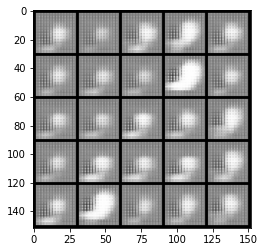

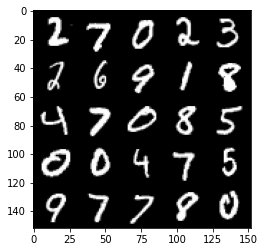

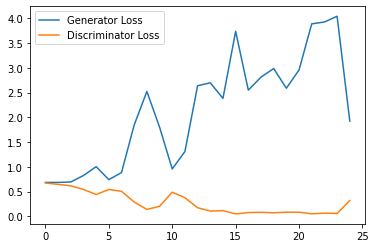

Step 1000: Generator loss: 3.657818818092346, discriminator loss: 0.08940207962691783


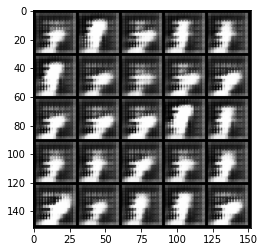

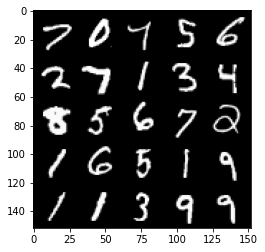

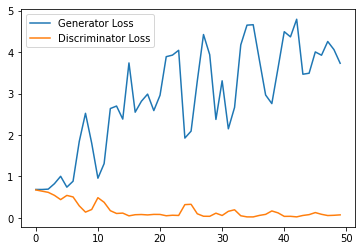

Step 1500: Generator loss: 3.899419766902924, discriminator loss: 0.07556297415681183


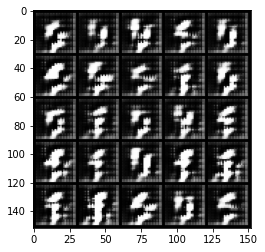

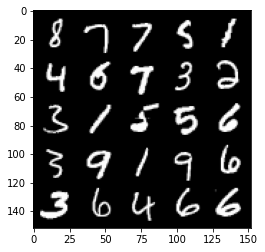

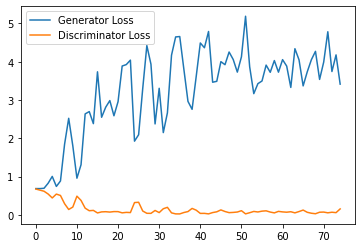

Step 2000: Generator loss: 3.767739701747894, discriminator loss: 0.12813904674351215


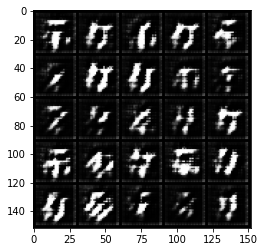

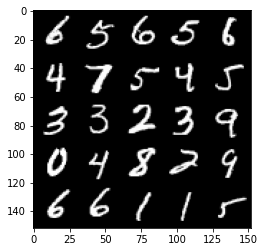

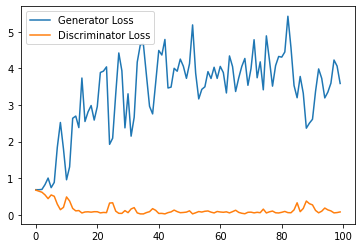

Step 2500: Generator loss: 2.9842779700756075, discriminator loss: 0.18847116497904062


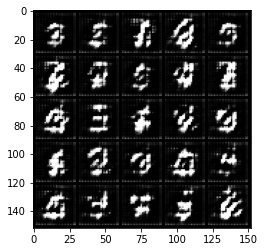

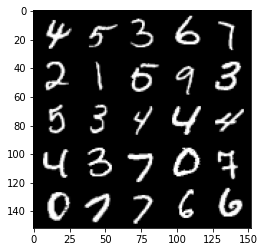

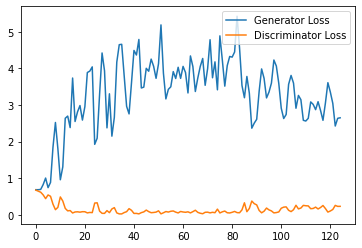

Step 3000: Generator loss: 2.40508739566803, discriminator loss: 0.2592567003667355


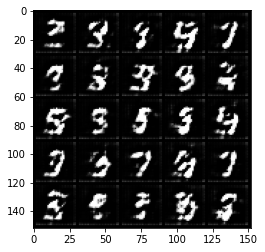

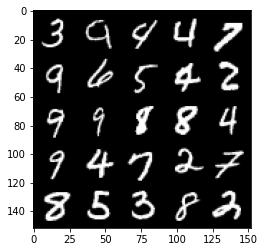

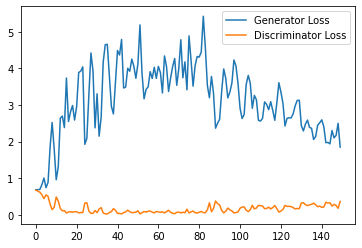

Step 3500: Generator loss: 2.088217946767807, discriminator loss: 0.3472826570868492


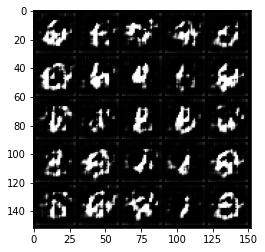

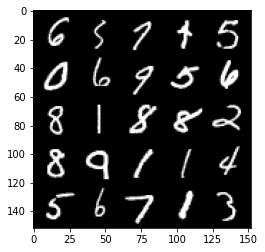

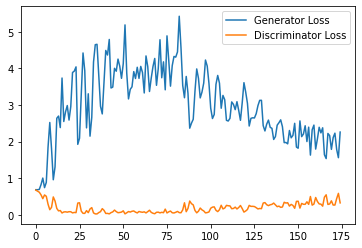

Step 4000: Generator loss: 1.9875416204929353, discriminator loss: 0.32605623999238015


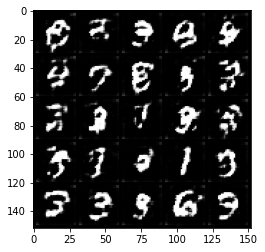

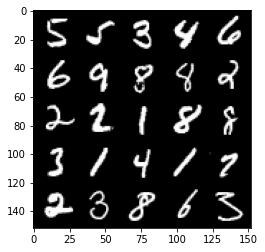

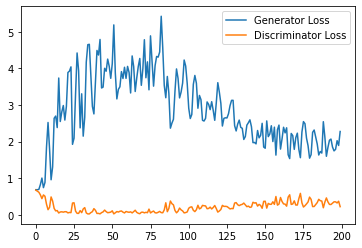

Step 4500: Generator loss: 1.9713728759288789, discriminator loss: 0.34346685916185377


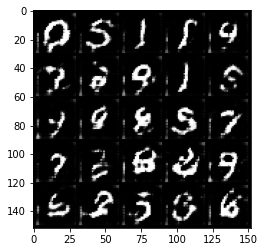

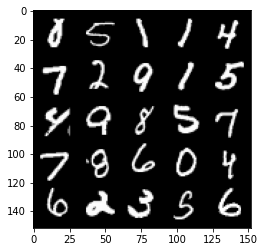

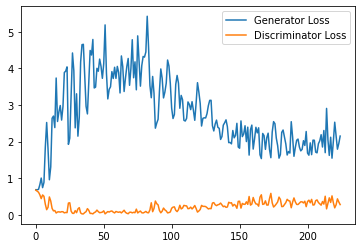

Step 5000: Generator loss: 1.8664722788333892, discriminator loss: 0.34331057354807853


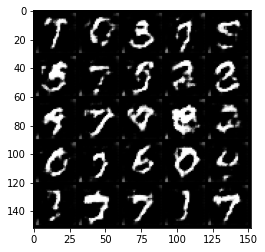

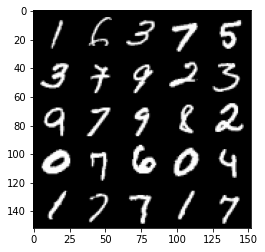

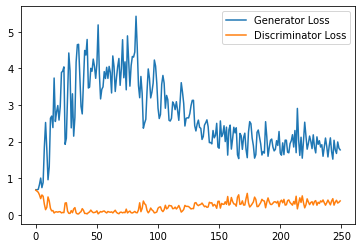

Step 5500: Generator loss: 1.7955330090522765, discriminator loss: 0.39750929868221285


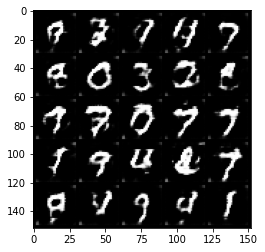

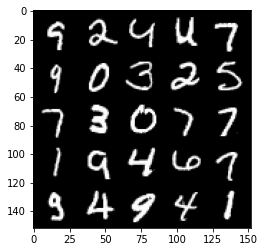

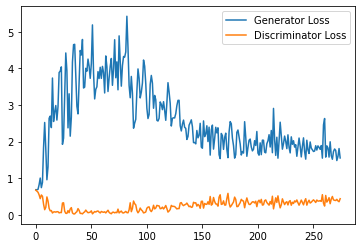

Step 6000: Generator loss: 1.6726726608276368, discriminator loss: 0.4218500625193119


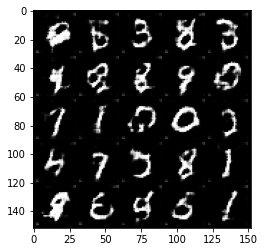

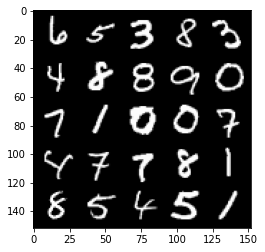

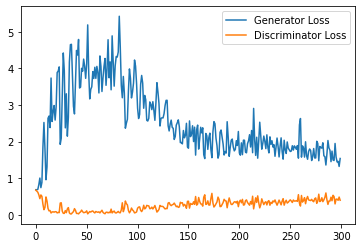

Step 6500: Generator loss: 1.4980771067142487, discriminator loss: 0.4401422627568245


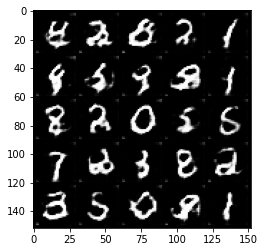

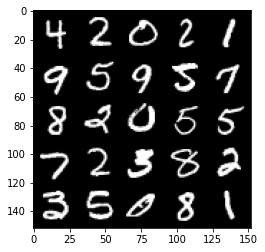

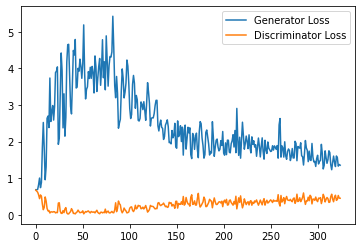

Step 7000: Generator loss: 1.4176069045066833, discriminator loss: 0.46279007428884505


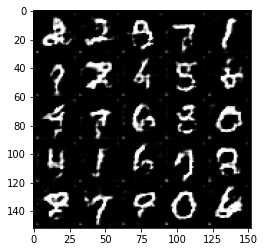

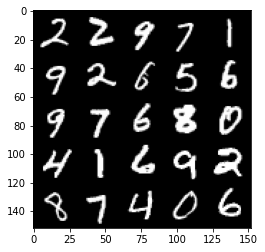

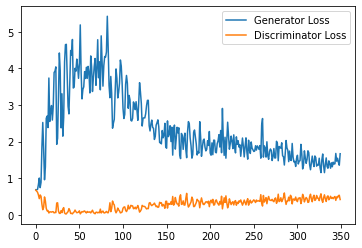

Step 7500: Generator loss: 1.3959525765180587, discriminator loss: 0.500421640098095


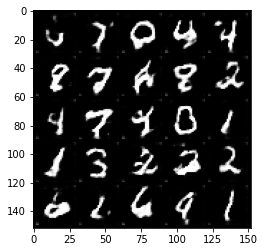

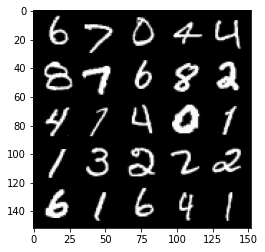

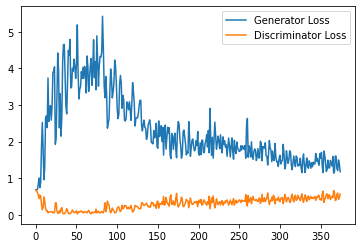

Step 8000: Generator loss: 1.2477826346158982, discriminator loss: 0.5337764364480972


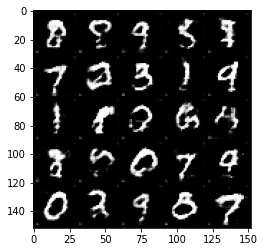

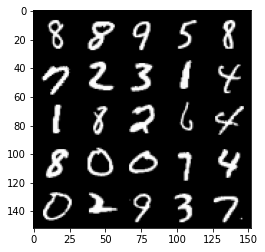

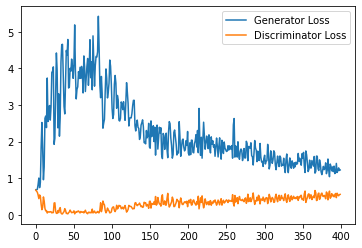

Step 8500: Generator loss: 1.2845397349596024, discriminator loss: 0.5310266959667206


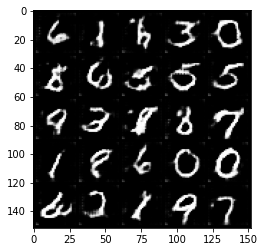

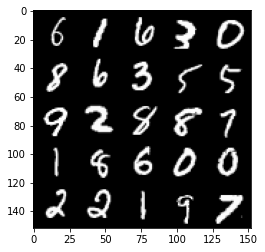

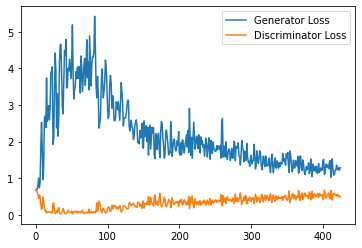

Step 9000: Generator loss: 1.2136943697929383, discriminator loss: 0.5543192924261093


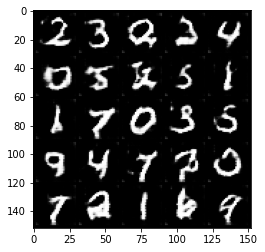

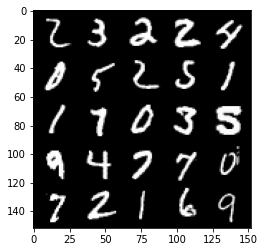

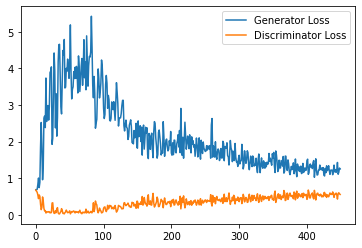

Step 9500: Generator loss: 1.1843624907732009, discriminator loss: 0.5597321493029594


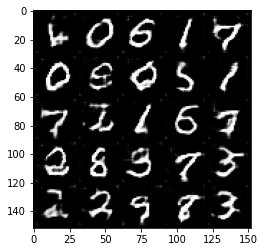

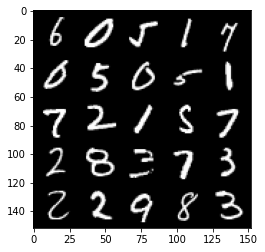

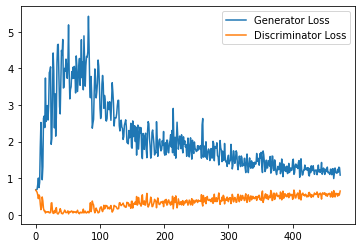

Step 10000: Generator loss: 1.135815567612648, discriminator loss: 0.5588688116073608


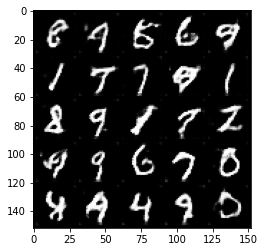

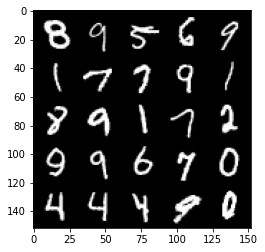

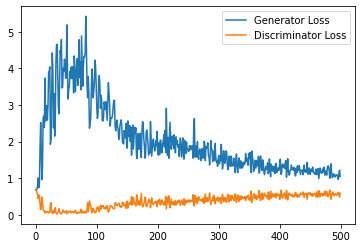

Step 10500: Generator loss: 1.109887110233307, discriminator loss: 0.5717278564572335


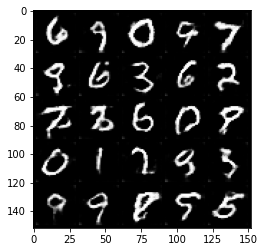

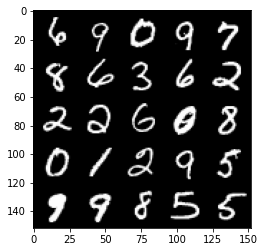

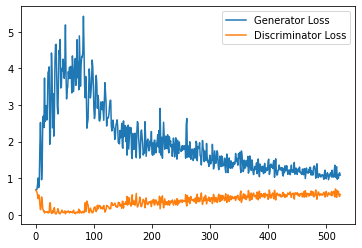

Step 11000: Generator loss: 1.0862764174938202, discriminator loss: 0.5828778284192085


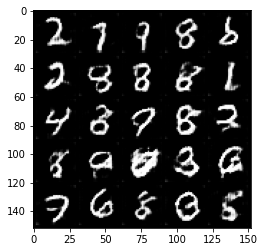

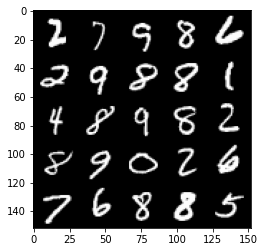

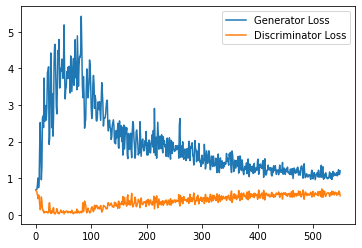

Step 11500: Generator loss: 1.150276319026947, discriminator loss: 0.5831753323674203


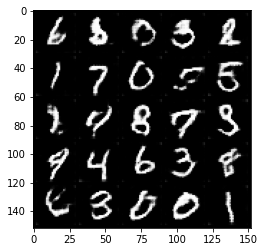

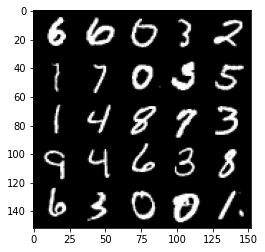

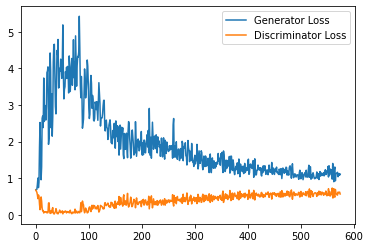

Step 12000: Generator loss: 1.0784100325107575, discriminator loss: 0.5870332230329514


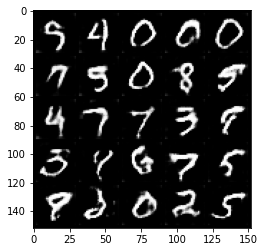

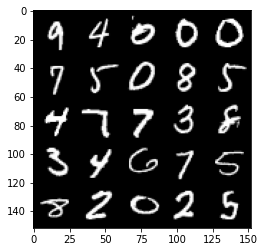

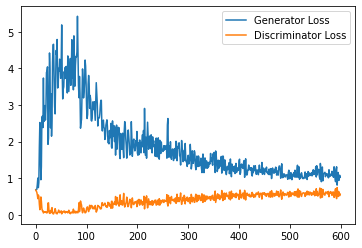

Step 12500: Generator loss: 1.0504241480827332, discriminator loss: 0.5941137790083885


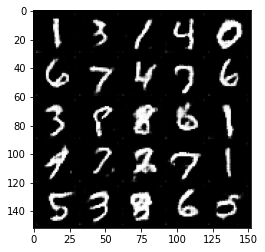

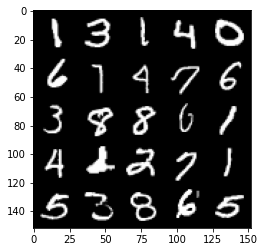

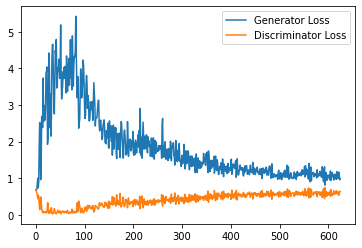

Step 13000: Generator loss: 1.040161468744278, discriminator loss: 0.5978254885077476


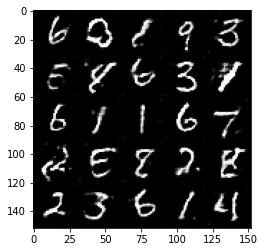

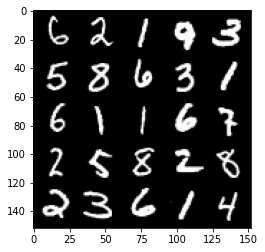

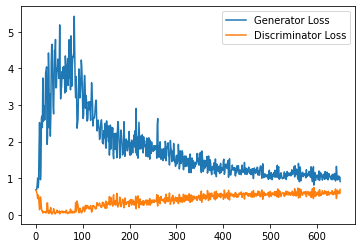

Step 13500: Generator loss: 1.0177437621355057, discriminator loss: 0.6011591903567314


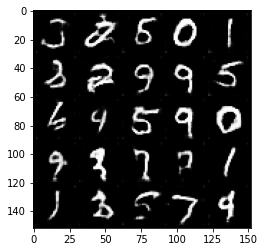

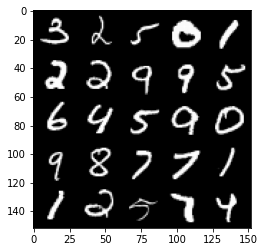

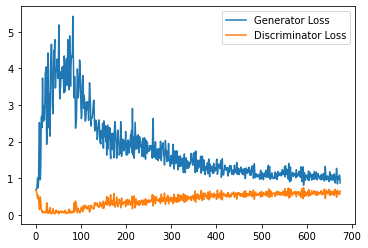

Step 14000: Generator loss: 1.0099838231801987, discriminator loss: 0.6033369554877281


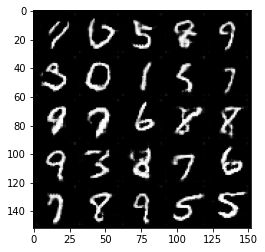

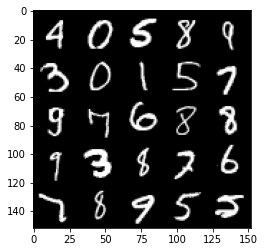

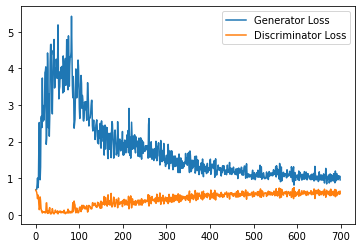

Step 14500: Generator loss: 0.9987430394887924, discriminator loss: 0.5990282633304596


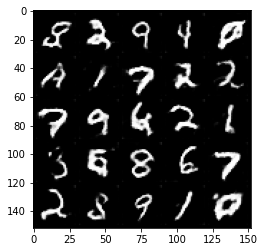

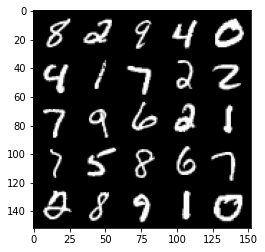

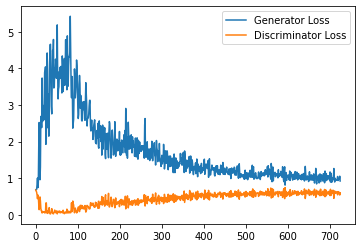

Step 15000: Generator loss: 0.9826474870443345, discriminator loss: 0.6083484896421433


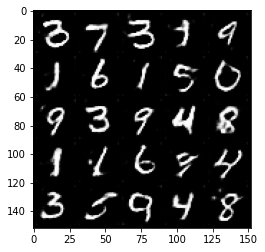

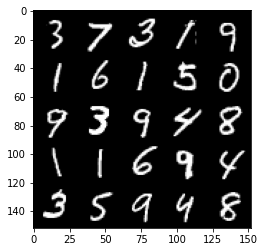

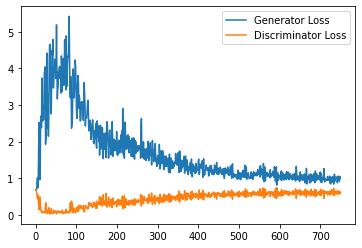

Step 15500: Generator loss: 1.0120973516702652, discriminator loss: 0.6065480358600617


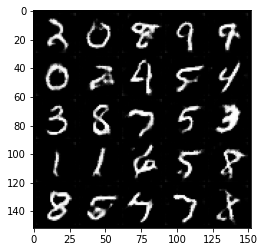

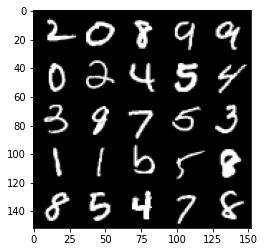

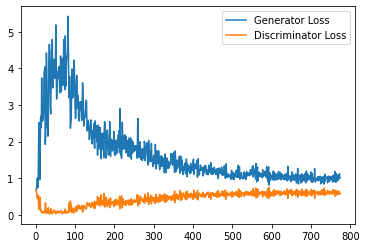

Step 16000: Generator loss: 1.0070392549037934, discriminator loss: 0.5969904648065567


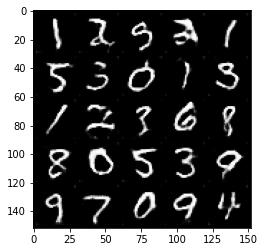

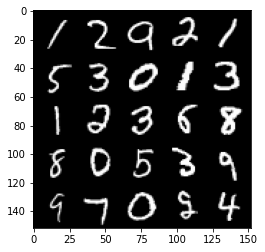

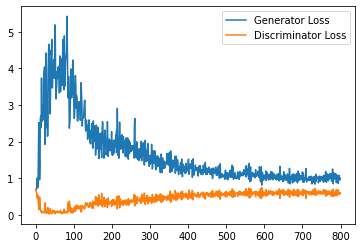

Step 16500: Generator loss: 1.0181544330120087, discriminator loss: 0.6076616883277893


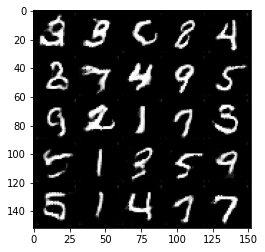

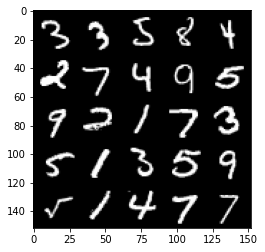

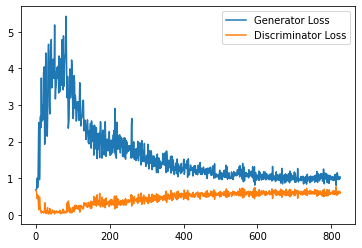

Step 17000: Generator loss: 0.9888491916656494, discriminator loss: 0.6024287851452828


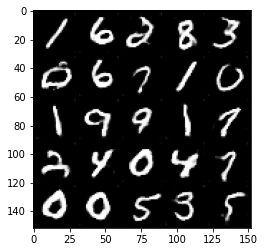

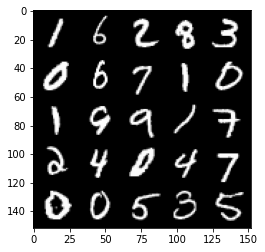

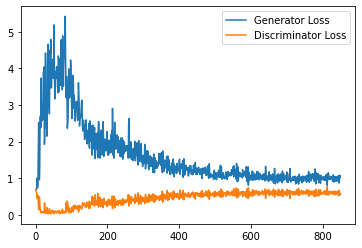

Step 17500: Generator loss: 0.9912086441516876, discriminator loss: 0.6009285348653793


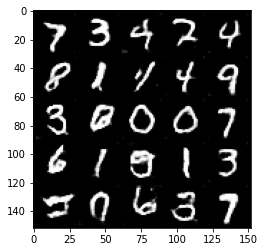

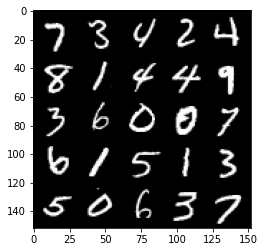

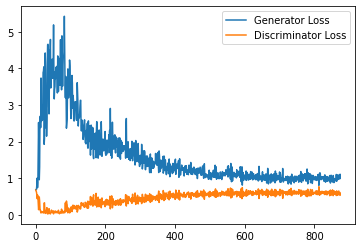

Step 18000: Generator loss: 0.9998710396289825, discriminator loss: 0.6040181168913841


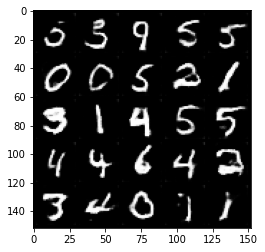

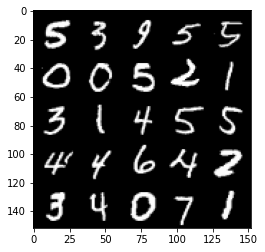

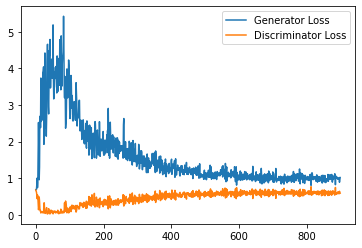

Step 18500: Generator loss: 1.017888055205345, discriminator loss: 0.5970340201258659


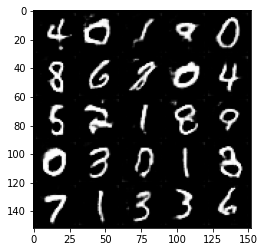

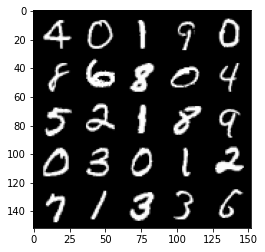

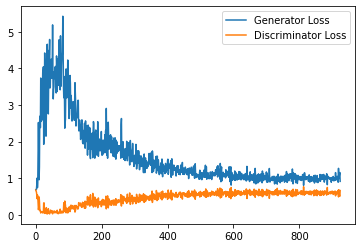

Step 19000: Generator loss: 0.9933246846199035, discriminator loss: 0.6041426309347153


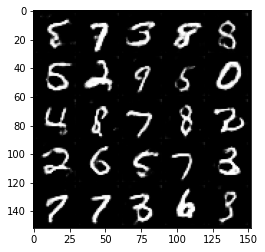

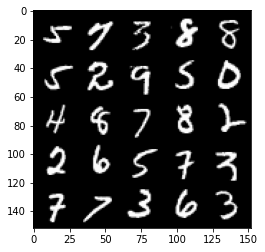

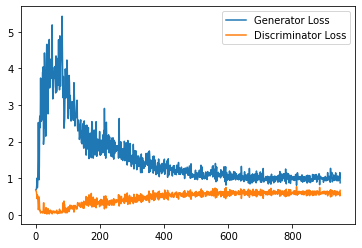

Step 19500: Generator loss: 0.9792309640645981, discriminator loss: 0.6025025140047073


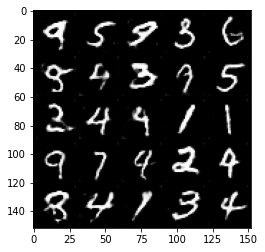

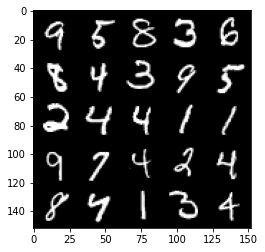

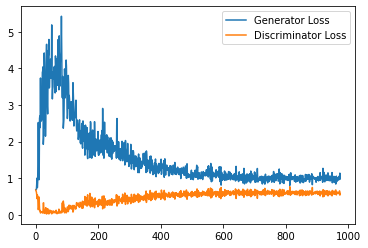

Step 20000: Generator loss: 1.0021503839492798, discriminator loss: 0.6053622681498527


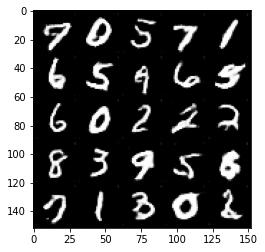

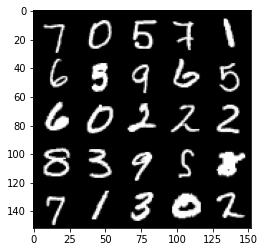

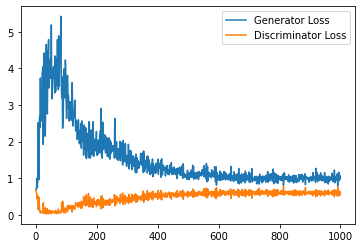

Step 20500: Generator loss: 0.9828199224472046, discriminator loss: 0.6049083938002586


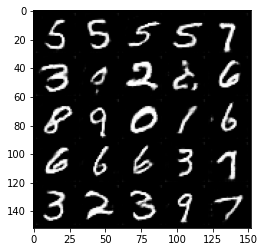

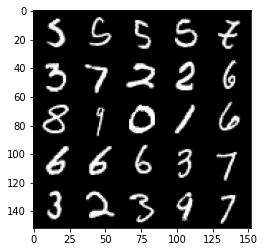

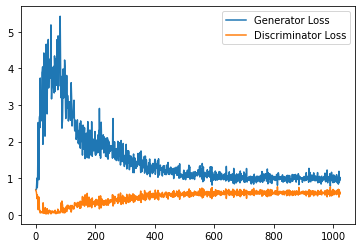

Step 21000: Generator loss: 0.9600150125026703, discriminator loss: 0.6069429625272751


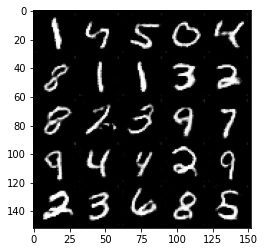

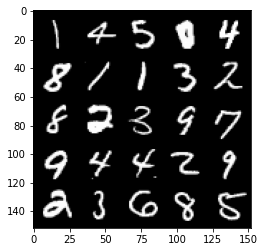

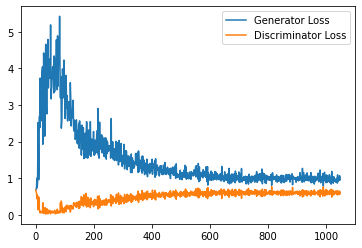

Step 21500: Generator loss: 0.9810557769536972, discriminator loss: 0.6152228652238846


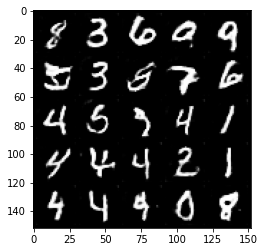

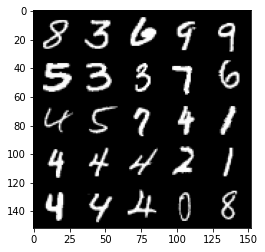

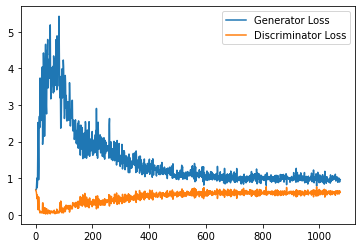

Step 22000: Generator loss: 0.9461324551105499, discriminator loss: 0.606569342136383


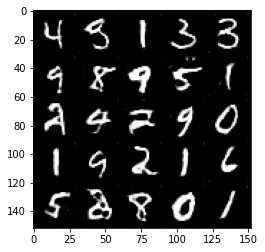

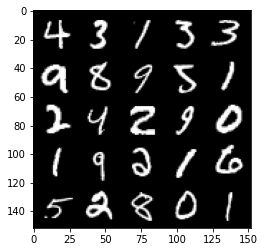

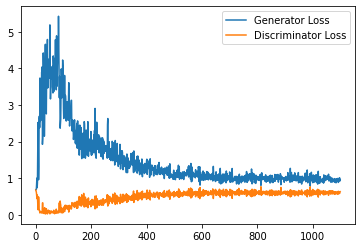

Step 22500: Generator loss: 1.0010850147008896, discriminator loss: 0.6052514407038688


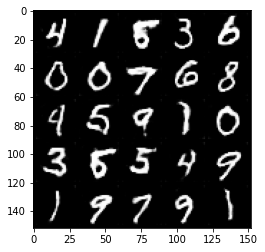

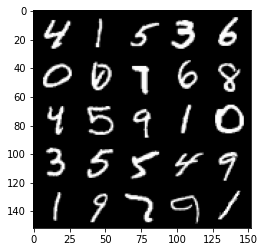

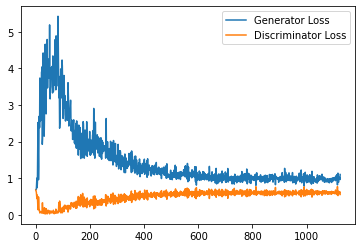

Step 23000: Generator loss: 0.9608864068984986, discriminator loss: 0.6126353176236152


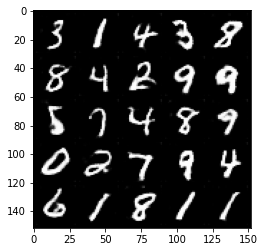

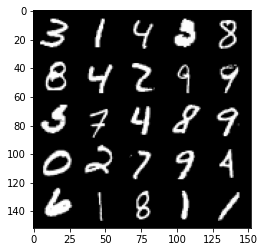

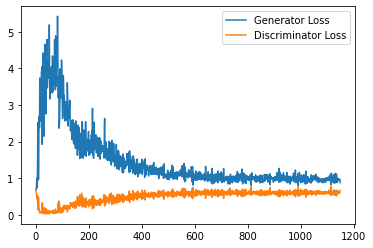

Step 23500: Generator loss: 0.9633374789953232, discriminator loss: 0.6060973088145256


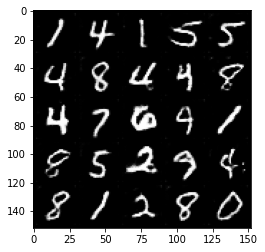

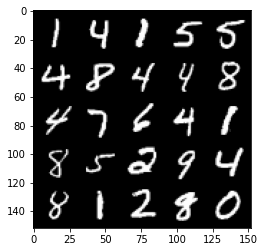

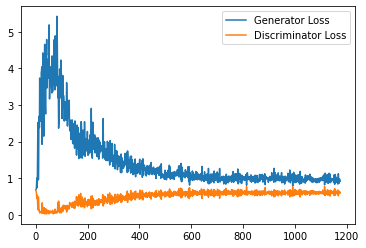

Step 24000: Generator loss: 0.9567593973875046, discriminator loss: 0.611027381837368


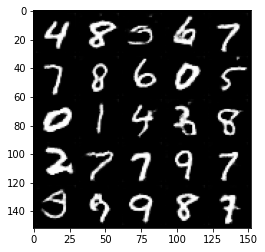

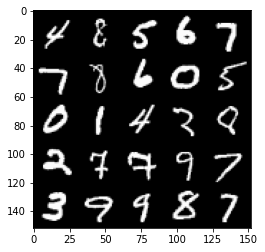

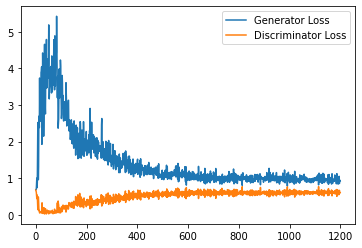

Step 24500: Generator loss: 0.9524944036006927, discriminator loss: 0.611556741654873


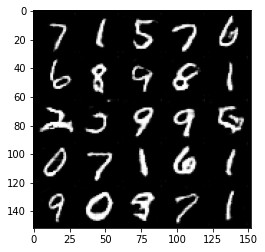

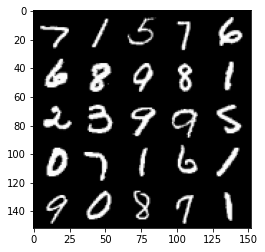

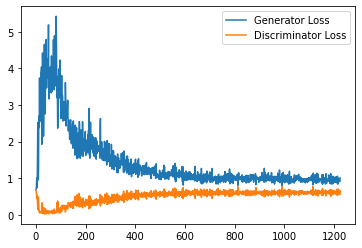

Step 25000: Generator loss: 0.9474700685739518, discriminator loss: 0.6168408667445183


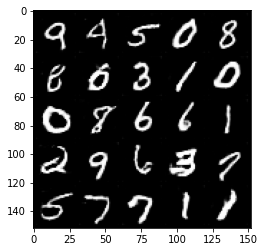

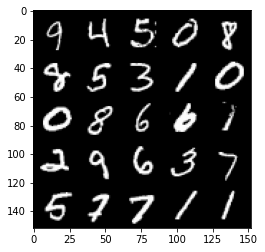

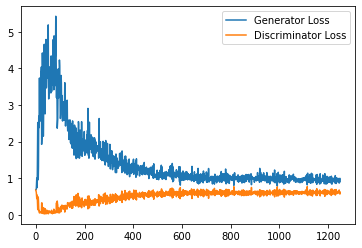

Step 25500: Generator loss: 0.9452016594409942, discriminator loss: 0.6151932496428489


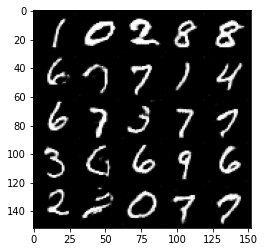

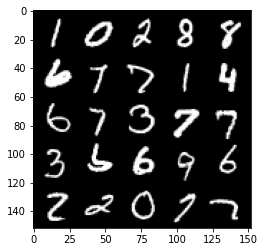

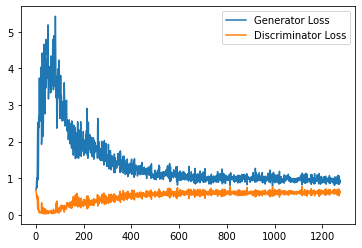

Step 26000: Generator loss: 0.96323719227314, discriminator loss: 0.6091757572293282


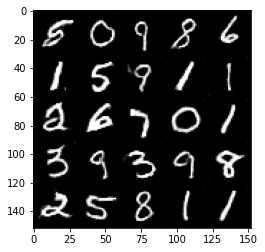

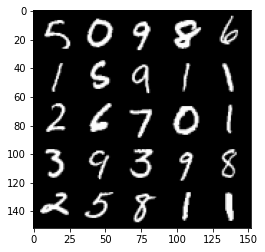

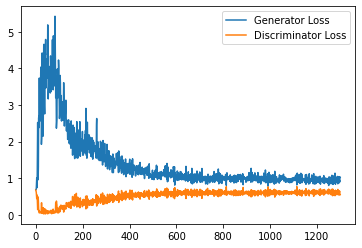

Step 26500: Generator loss: 0.9565556206703186, discriminator loss: 0.6156624833345413


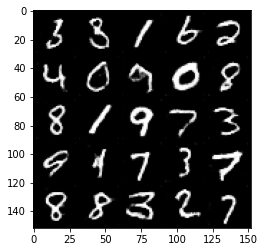

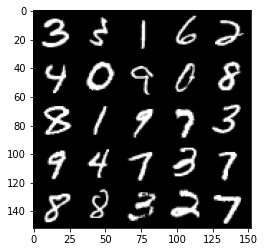

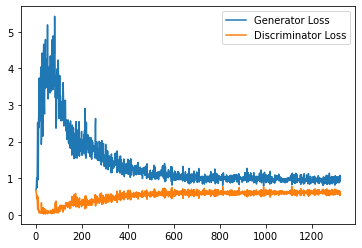

Step 27000: Generator loss: 0.9684630377292633, discriminator loss: 0.619351796746254


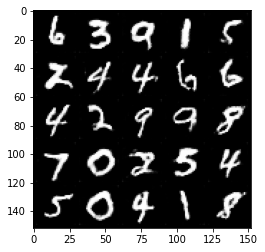

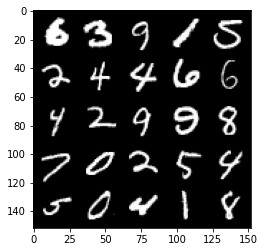

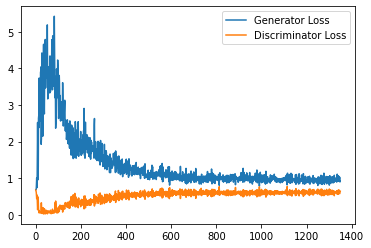

Step 27500: Generator loss: 0.9615843040943146, discriminator loss: 0.6128430360555649


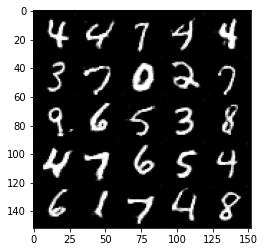

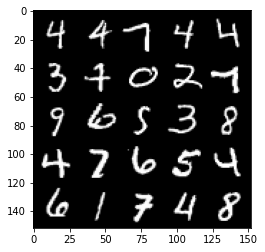

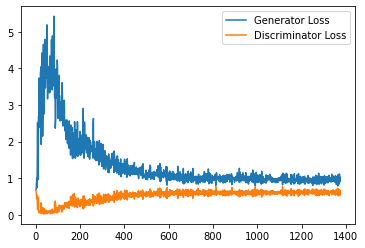

Step 28000: Generator loss: 0.9359905323982238, discriminator loss: 0.6153213437795639


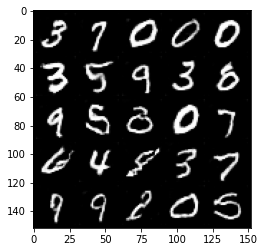

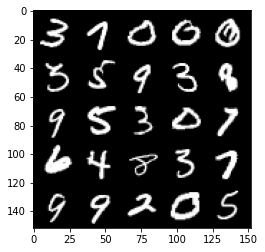

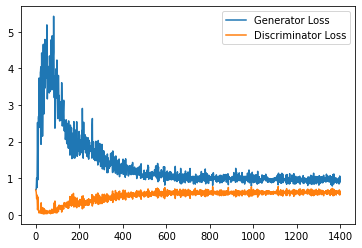

Step 28500: Generator loss: 0.938257023692131, discriminator loss: 0.6119348115324974


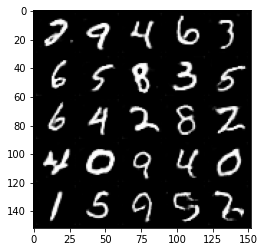

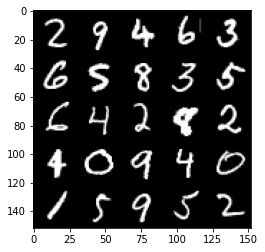

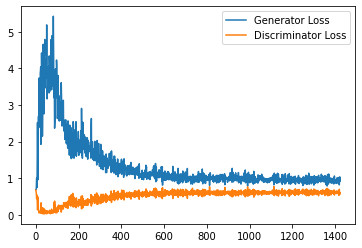

Step 29000: Generator loss: 0.9504080892801284, discriminator loss: 0.6106056612730026


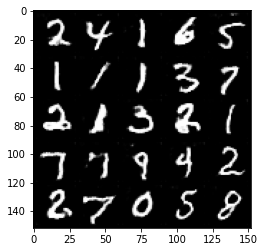

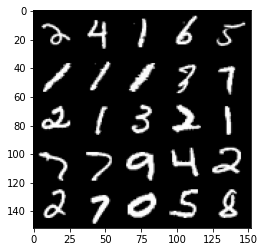

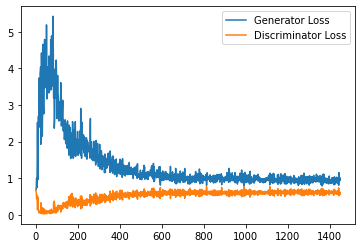

Step 29500: Generator loss: 0.9524036823511124, discriminator loss: 0.6148033203482628


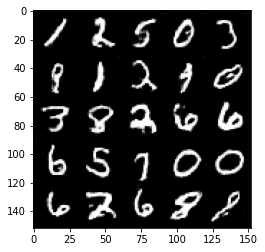

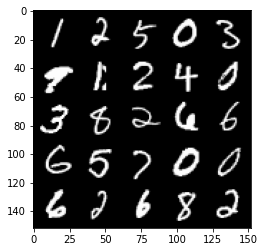

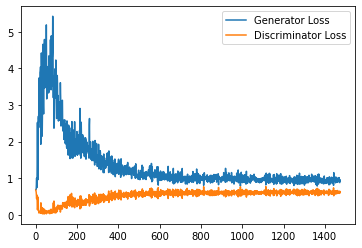

Step 30000: Generator loss: 0.9488342047929764, discriminator loss: 0.6100144605040551


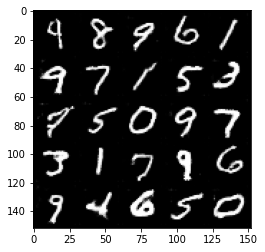

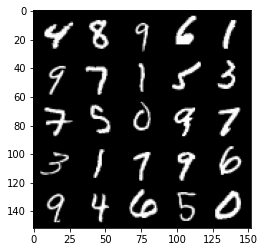

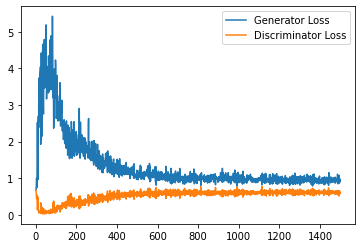

Step 30500: Generator loss: 0.941836154460907, discriminator loss: 0.6088608974218368


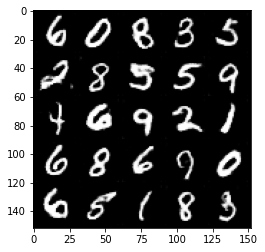

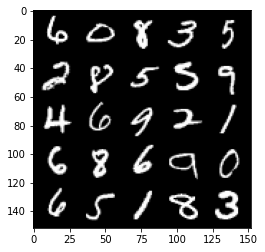

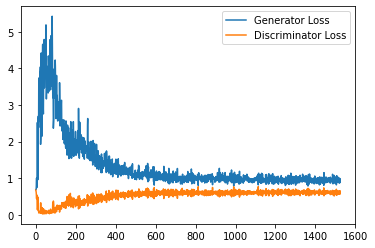

Step 31000: Generator loss: 0.9404535632133484, discriminator loss: 0.6105549770593643


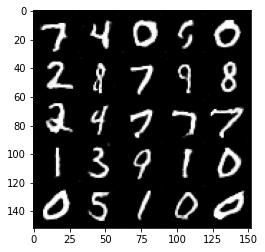

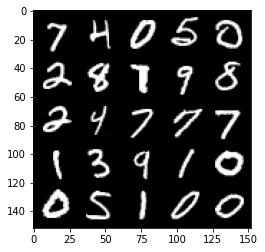

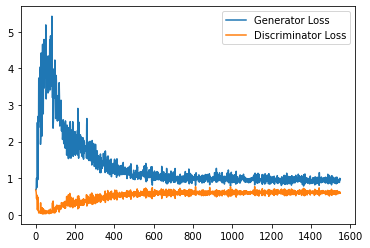

Step 31500: Generator loss: 0.9443001940250396, discriminator loss: 0.6112699884176255


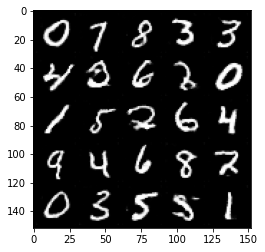

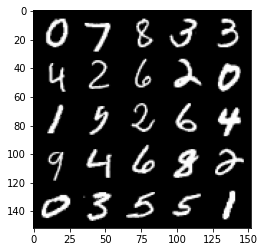

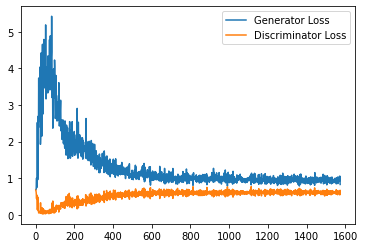

Step 32000: Generator loss: 0.9392781797647476, discriminator loss: 0.608397123336792


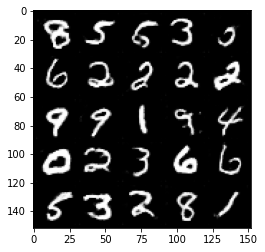

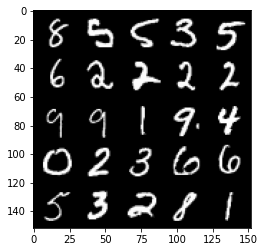

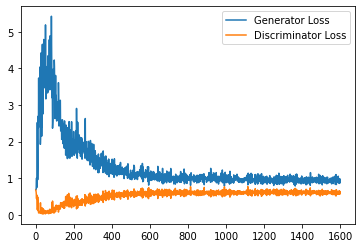

Step 32500: Generator loss: 0.9465888314247132, discriminator loss: 0.6095444993972778


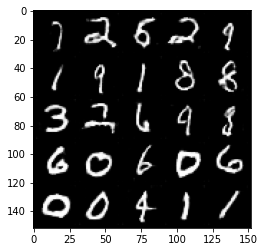

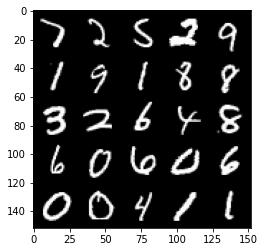

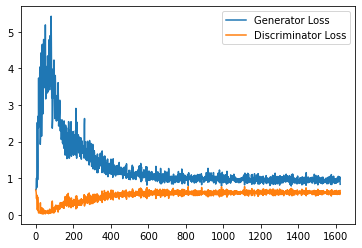

Step 33000: Generator loss: 0.9275720572471619, discriminator loss: 0.608994821369648


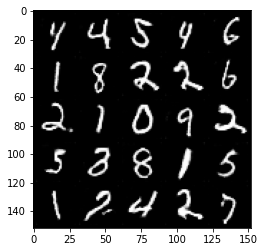

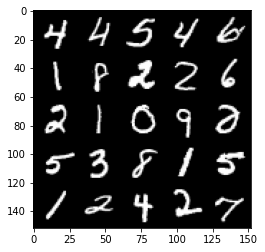

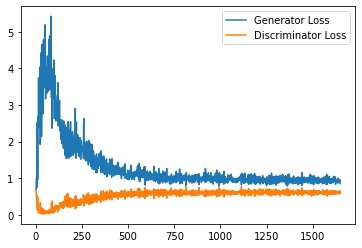

Step 33500: Generator loss: 0.9479077724218369, discriminator loss: 0.6061068317890167


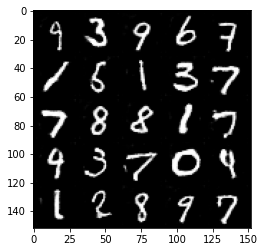

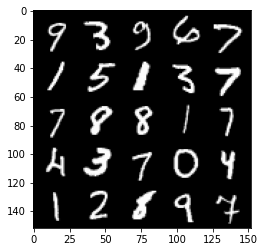

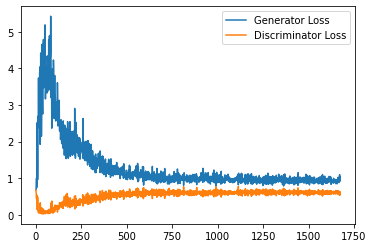

Step 34000: Generator loss: 0.9473393611907959, discriminator loss: 0.6112890572547912


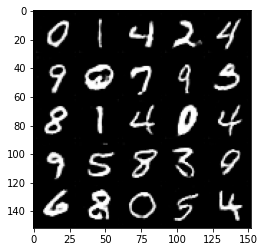

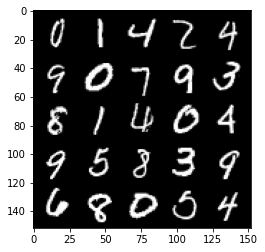

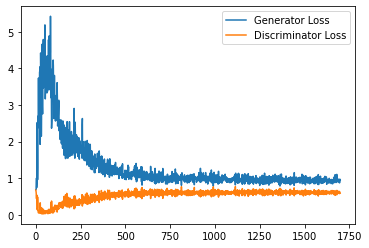

Step 34500: Generator loss: 0.9285798524618148, discriminator loss: 0.6124925717115403


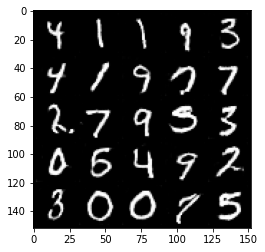

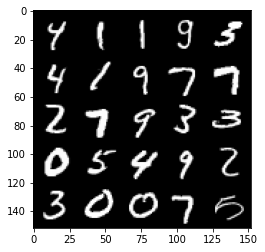

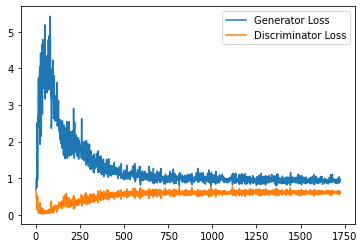

Step 35000: Generator loss: 0.9387662050724029, discriminator loss: 0.6148913437128067


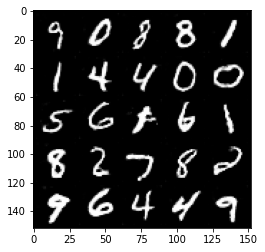

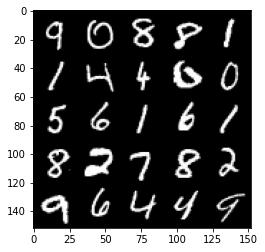

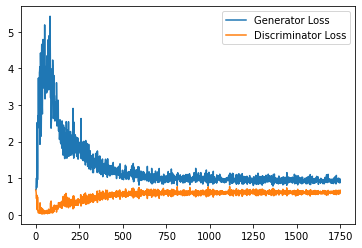

Step 35500: Generator loss: 0.9278832656145096, discriminator loss: 0.6148752944469452


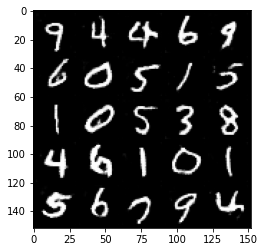

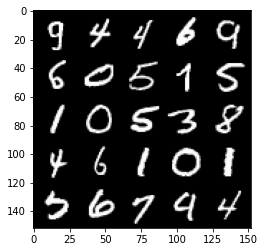

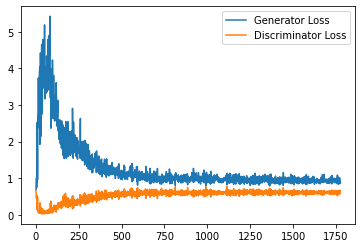

Step 36000: Generator loss: 0.9375658178329468, discriminator loss: 0.6131908000707627


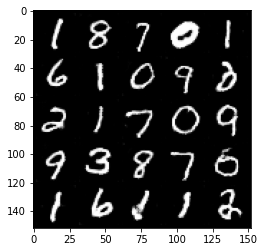

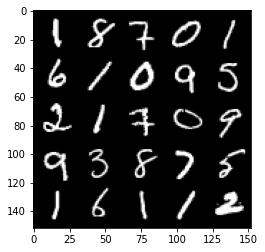

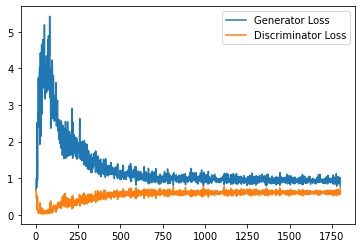

Step 36500: Generator loss: 0.9541778665781021, discriminator loss: 0.6063543771505355


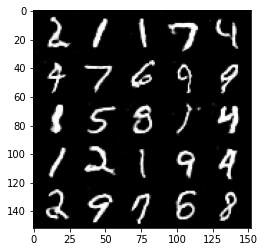

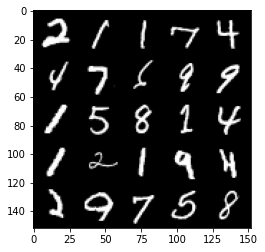

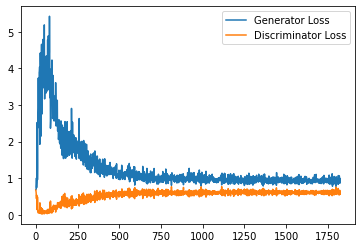

Step 37000: Generator loss: 0.9411257212162017, discriminator loss: 0.6136618362665176


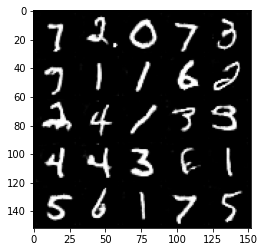

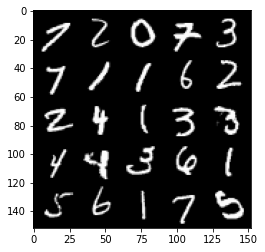

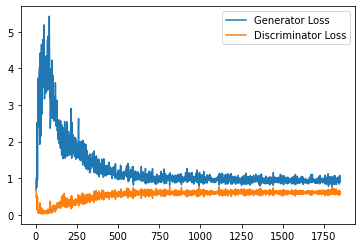

Step 37500: Generator loss: 0.9170818551778793, discriminator loss: 0.6128905898332596


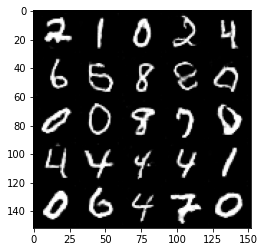

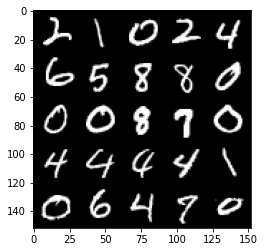

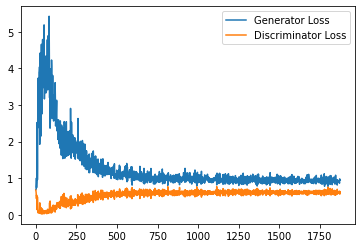

Step 38000: Generator loss: 0.9354910320043563, discriminator loss: 0.6161083500981331


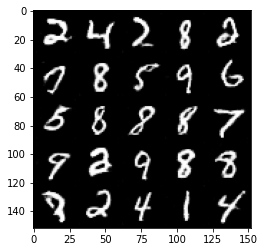

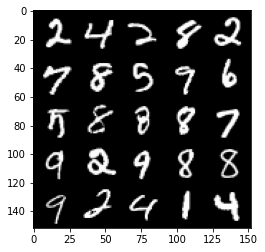

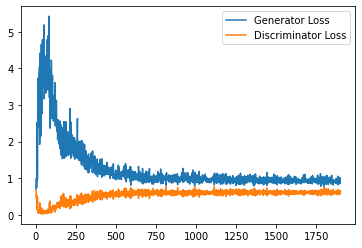

Step 38500: Generator loss: 0.948538475394249, discriminator loss: 0.6137994427084923


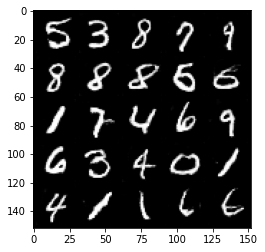

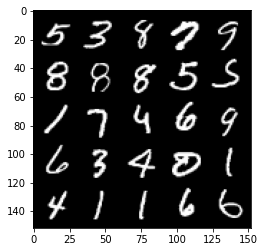

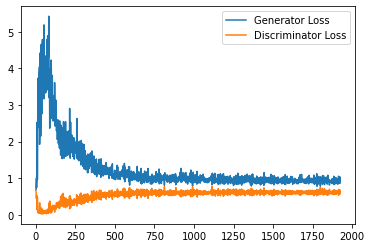

Step 39000: Generator loss: 0.9687613645792007, discriminator loss: 0.6052801519036293


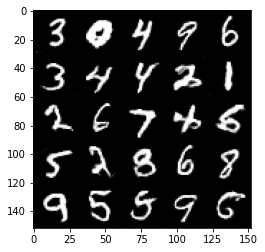

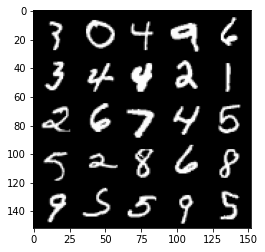

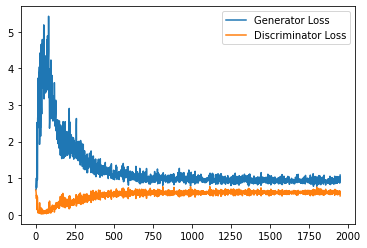

Step 39500: Generator loss: 0.9574587316513061, discriminator loss: 0.609951810002327


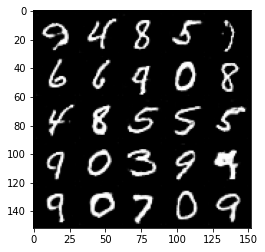

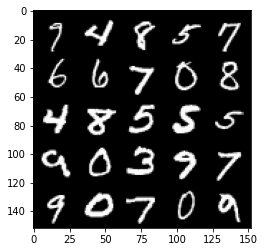

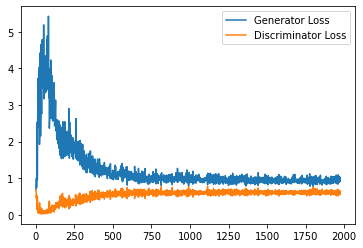

Step 40000: Generator loss: 0.9498729889392853, discriminator loss: 0.6145197530984878


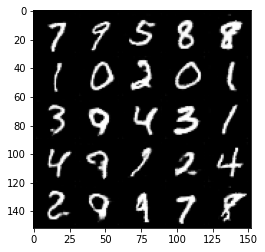

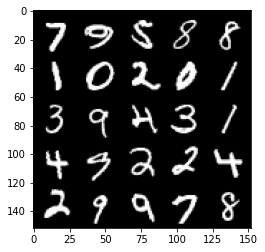

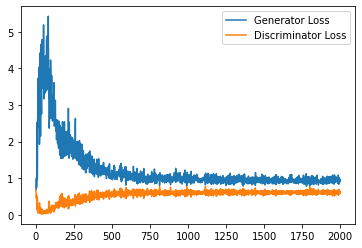

Step 40500: Generator loss: 0.9461500464677811, discriminator loss: 0.6126463352441788


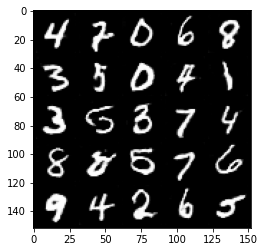

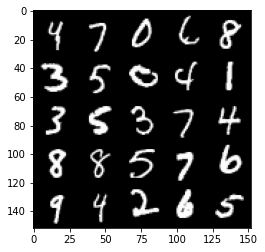

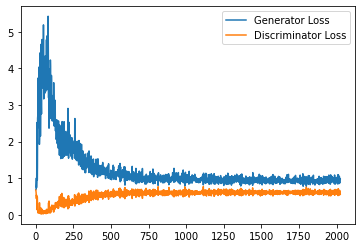

Step 41000: Generator loss: 0.9515019501447678, discriminator loss: 0.6097441574931145


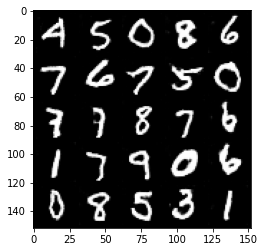

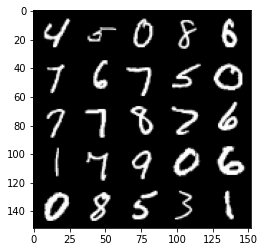

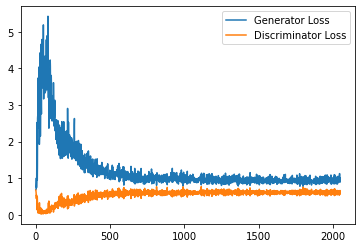

Step 41500: Generator loss: 0.9559282701015472, discriminator loss: 0.6088613215088844


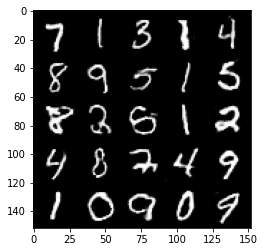

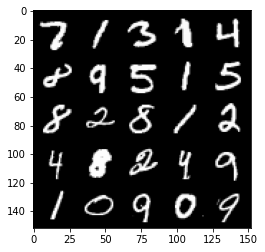

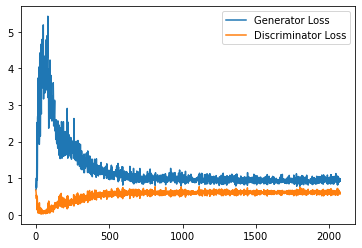

Step 42000: Generator loss: 0.9430260396003723, discriminator loss: 0.6102366354465485


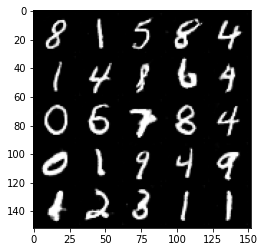

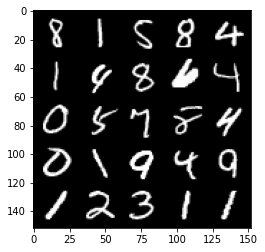

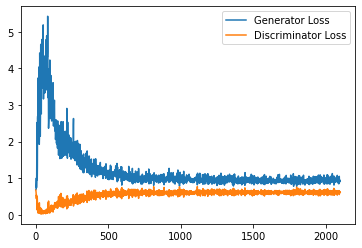

Step 42500: Generator loss: 0.9378850567340851, discriminator loss: 0.6072499316334724


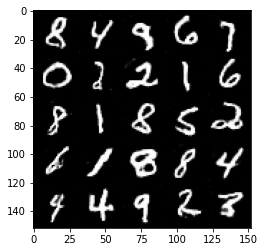

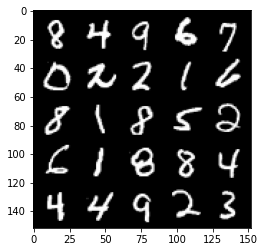

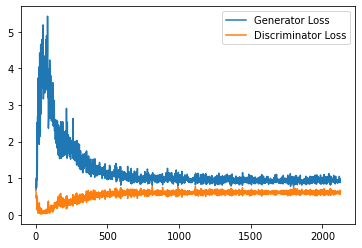

Step 43000: Generator loss: 0.9543411430120469, discriminator loss: 0.6155605028867721


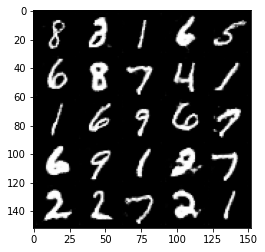

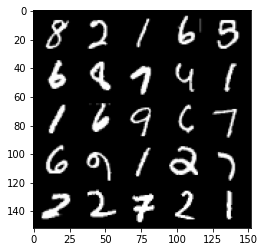

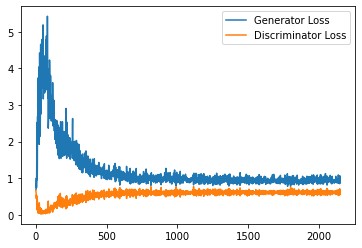

Step 43500: Generator loss: 0.9914596807956696, discriminator loss: 0.6058465083837509


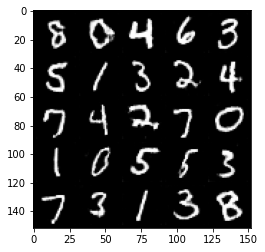

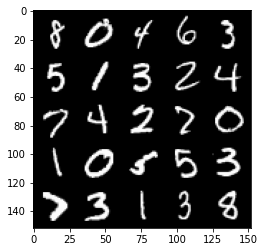

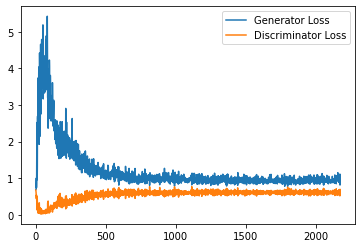

Step 44000: Generator loss: 0.9300283198356628, discriminator loss: 0.6100249660015106


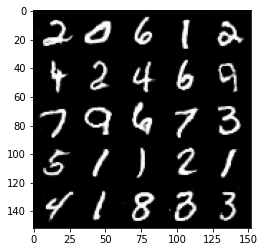

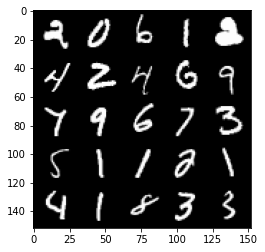

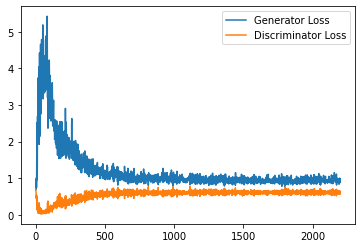

Step 44500: Generator loss: 0.9324932905435562, discriminator loss: 0.6112243338227272


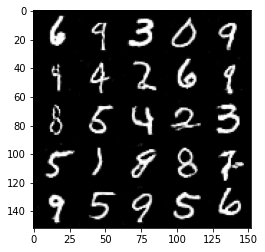

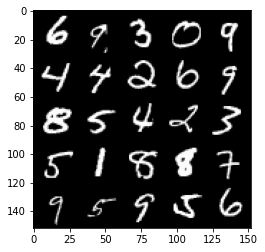

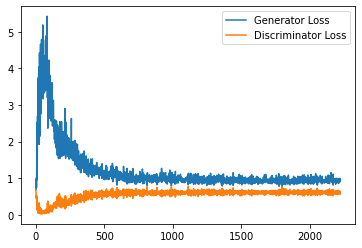

Step 45000: Generator loss: 0.9375967040061951, discriminator loss: 0.610162873506546


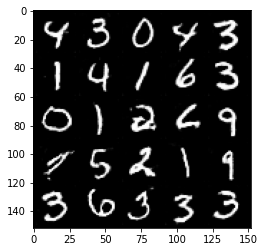

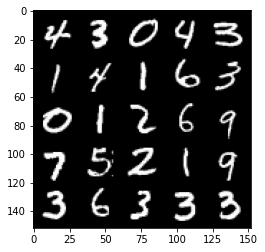

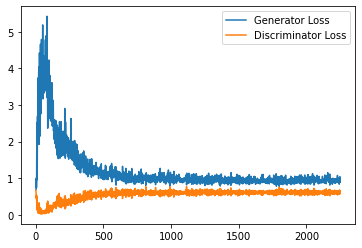

Step 45500: Generator loss: 0.9341823047399521, discriminator loss: 0.6057990873456002


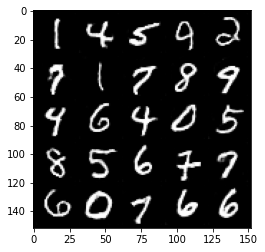

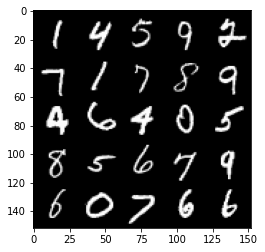

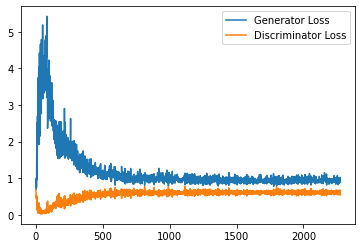

Step 46000: Generator loss: 0.9331419199705124, discriminator loss: 0.6169686302542686


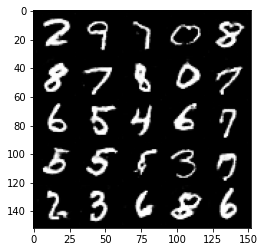

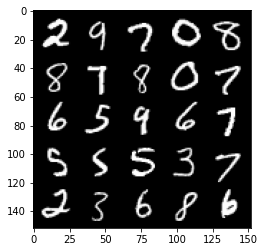

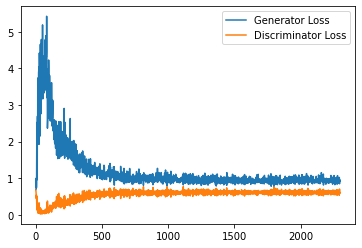

Step 46500: Generator loss: 0.9383216967582703, discriminator loss: 0.6149710540175438


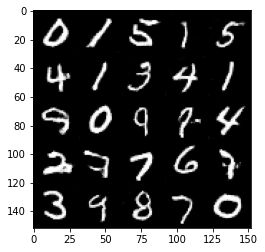

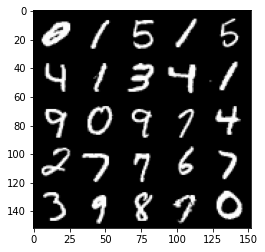

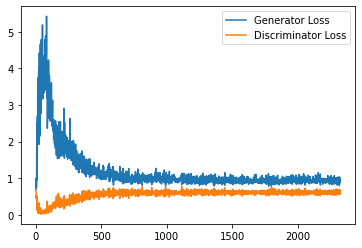

Step 47000: Generator loss: 0.9402495253086091, discriminator loss: 0.6133214445114136


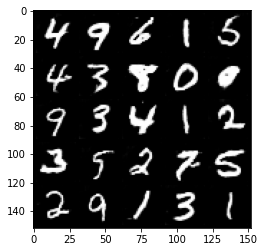

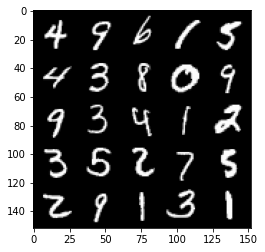

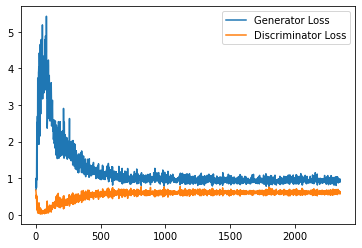

Step 47500: Generator loss: 0.9293381838798523, discriminator loss: 0.6137484666109085


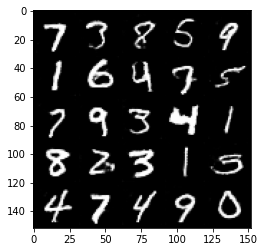

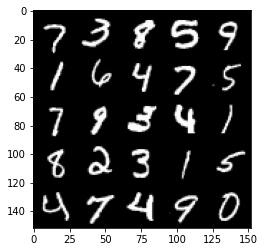

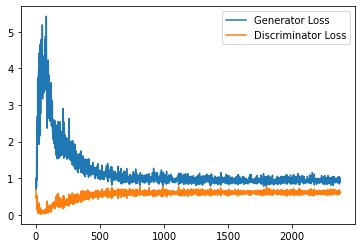

Step 48000: Generator loss: 0.9542753397226333, discriminator loss: 0.6120154101848603


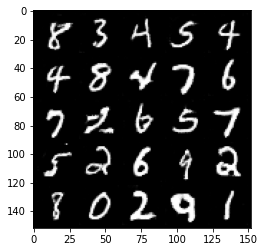

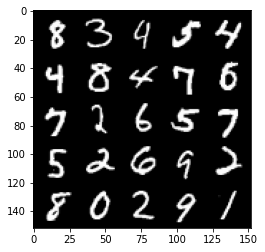

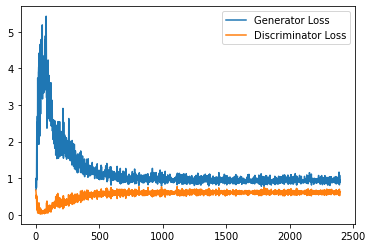

Step 48500: Generator loss: 0.95041848218441, discriminator loss: 0.6122613875865937


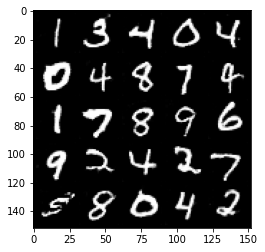

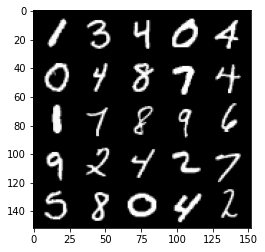

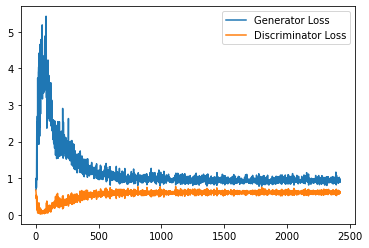

Step 49000: Generator loss: 0.9620730866193772, discriminator loss: 0.6078929651379585


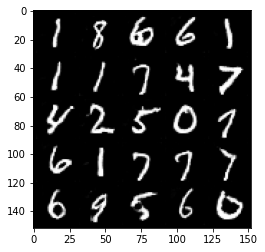

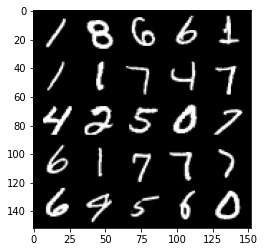

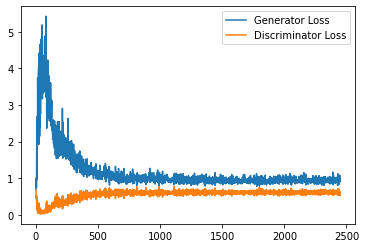

Step 49500: Generator loss: 0.9762745821475982, discriminator loss: 0.6120850896835327


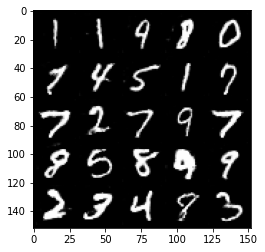

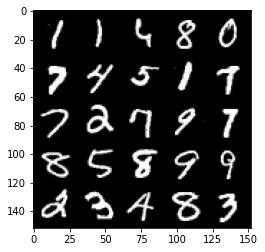

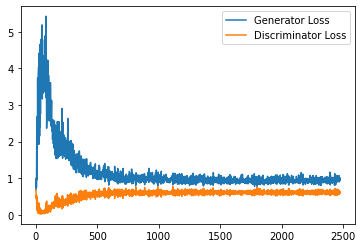

Step 50000: Generator loss: 0.9332051789760589, discriminator loss: 0.6125524678230285


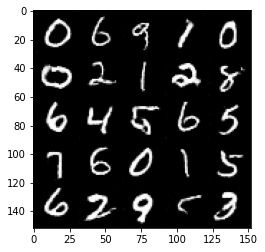

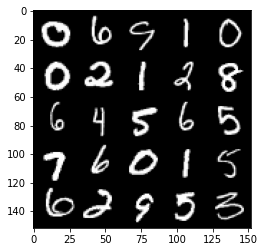

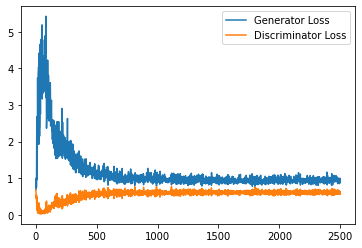

Step 50500: Generator loss: 0.942059504032135, discriminator loss: 0.6158383529782295


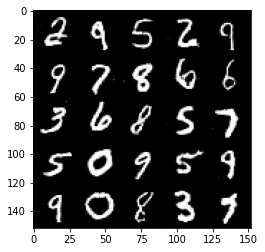

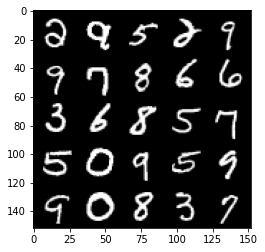

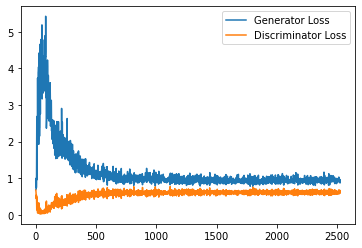

Step 51000: Generator loss: 0.9648231147527695, discriminator loss: 0.6090242338180542


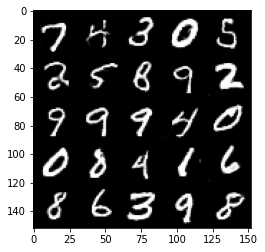

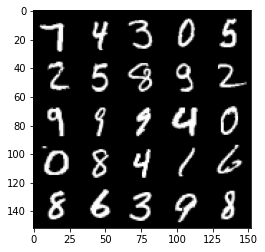

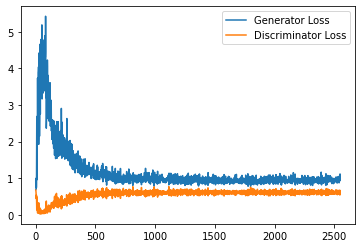

Step 51500: Generator loss: 0.9542568072080612, discriminator loss: 0.6091081228852272


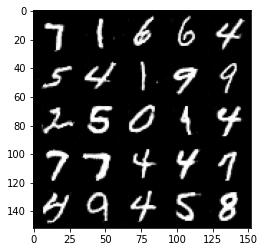

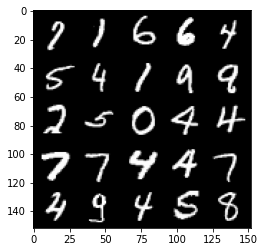

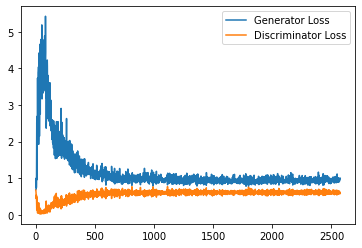

Step 52000: Generator loss: 0.9537624002695083, discriminator loss: 0.6166316866874695


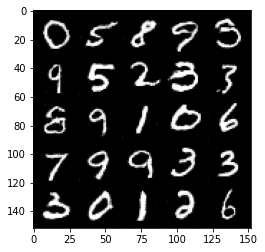

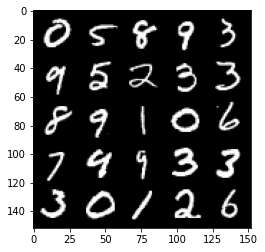

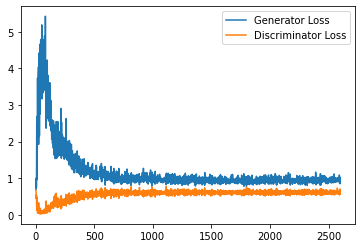

Step 52500: Generator loss: 0.954764700293541, discriminator loss: 0.6090942396521568


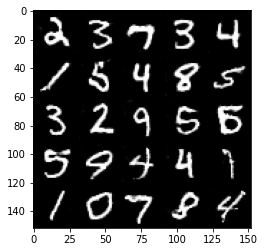

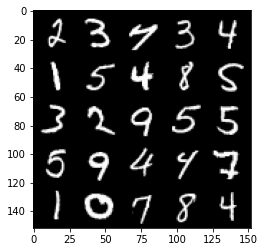

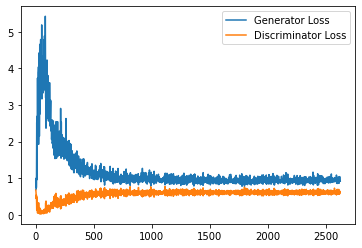

Step 53000: Generator loss: 0.9426500626802444, discriminator loss: 0.61039959192276


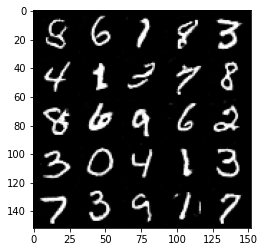

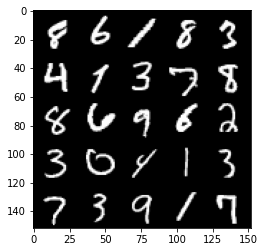

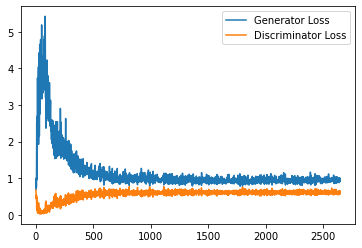

Step 53500: Generator loss: 0.9331113009452819, discriminator loss: 0.6084115090370178


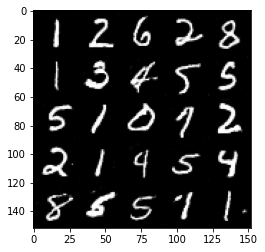

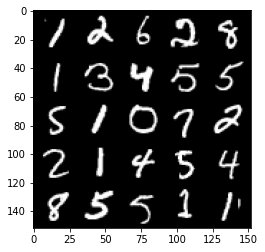

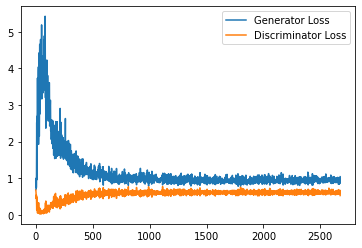

Step 54000: Generator loss: 0.9589165010452271, discriminator loss: 0.6121300324201584


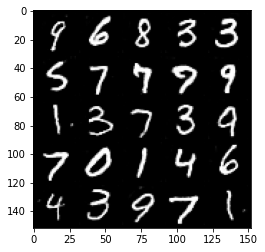

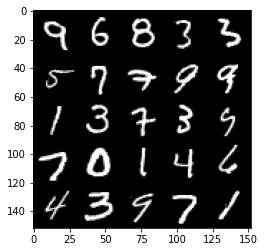

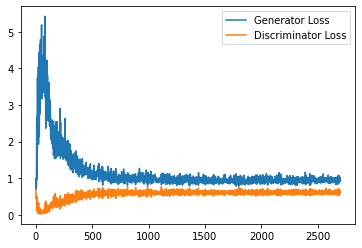

Step 54500: Generator loss: 0.9447139650583267, discriminator loss: 0.6125062910318375


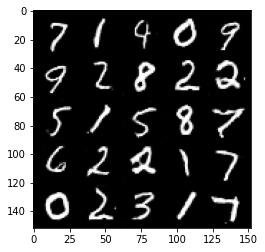

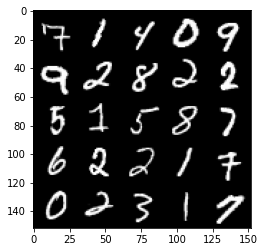

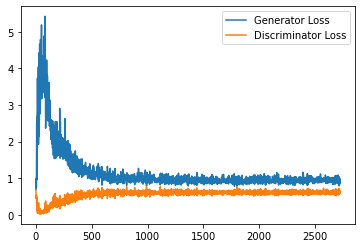

Step 55000: Generator loss: 0.9330358308553696, discriminator loss: 0.60900490629673


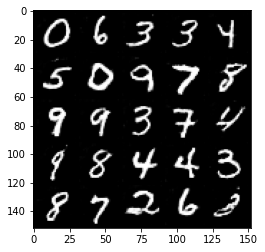

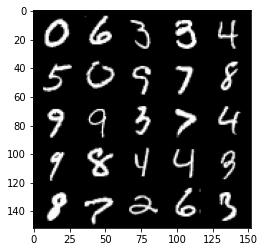

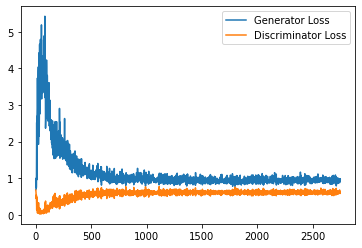

Step 55500: Generator loss: 0.9587607754468918, discriminator loss: 0.6137730774283409


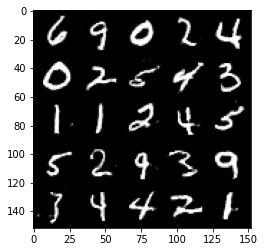

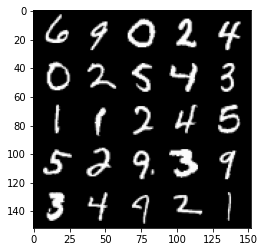

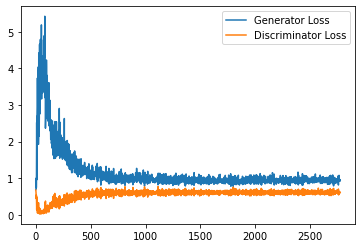

Step 56000: Generator loss: 0.9378480399847031, discriminator loss: 0.6152638667821884


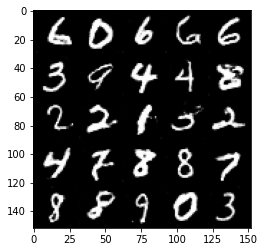

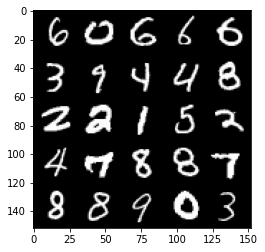

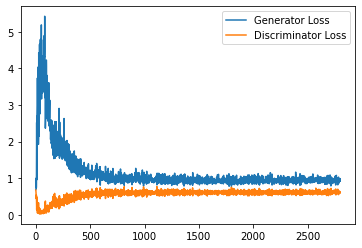

Step 56500: Generator loss: 0.9362954090833664, discriminator loss: 0.6122214139699936


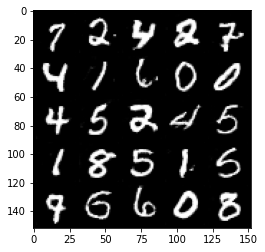

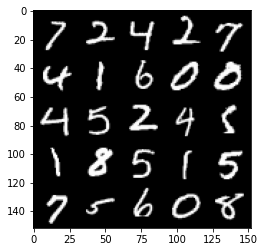

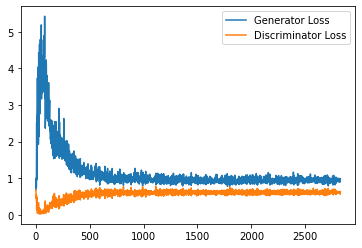

Step 57000: Generator loss: 0.9568220876455307, discriminator loss: 0.6070761250853538


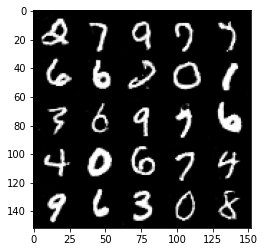

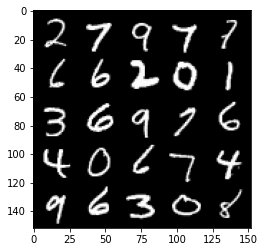

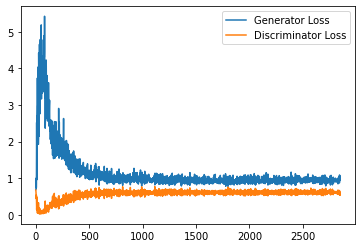

Step 57500: Generator loss: 0.9387260932922363, discriminator loss: 0.6139748553037644


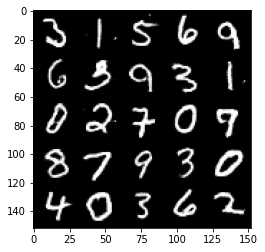

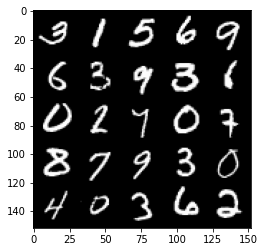

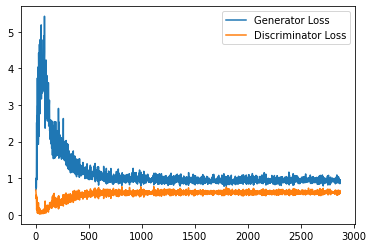

Step 58000: Generator loss: 0.9398435264825821, discriminator loss: 0.6114888404011727


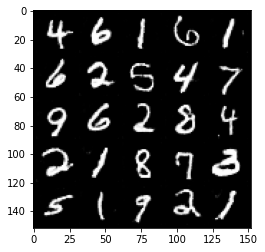

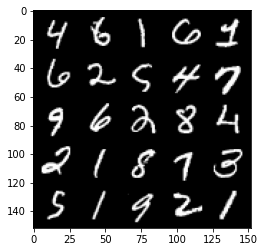

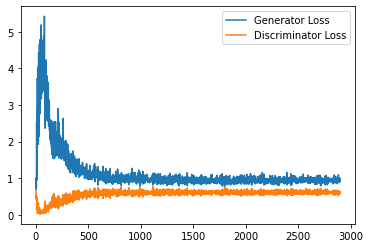

Step 58500: Generator loss: 0.9606753807067872, discriminator loss: 0.6105765327215195


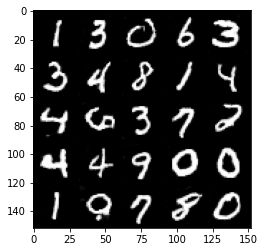

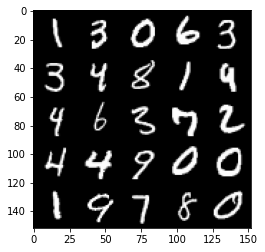

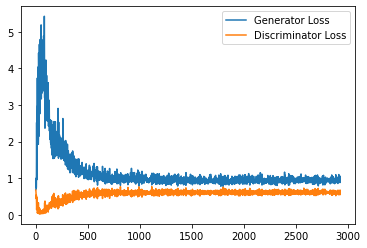

Step 59000: Generator loss: 0.9610591953992844, discriminator loss: 0.6221249197721481


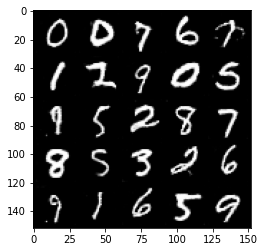

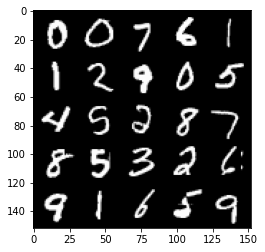

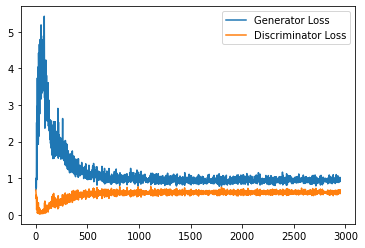

Step 59500: Generator loss: 0.9355372768640519, discriminator loss: 0.6192711842060089


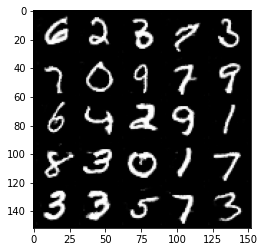

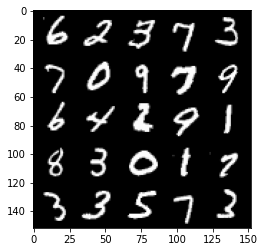

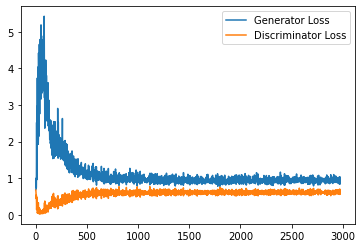

Step 60000: Generator loss: 0.926647305727005, discriminator loss: 0.6166975737810135


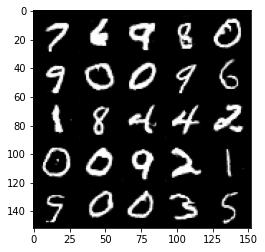

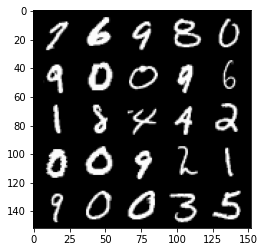

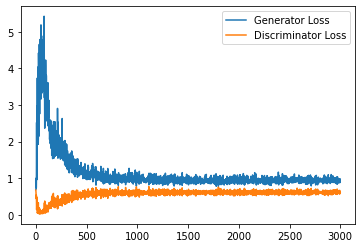

Step 60500: Generator loss: 0.9290595592260361, discriminator loss: 0.6175056508779526


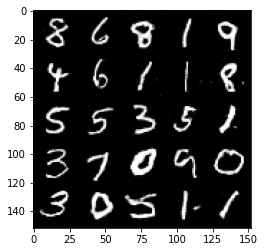

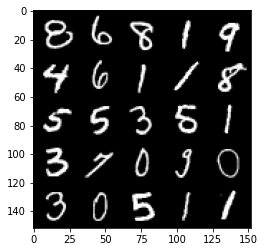

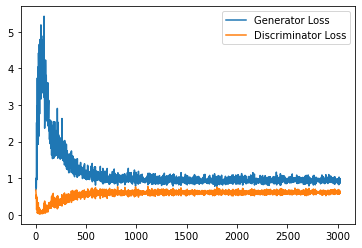

Step 61000: Generator loss: 0.9351286237239838, discriminator loss: 0.6138734540939331


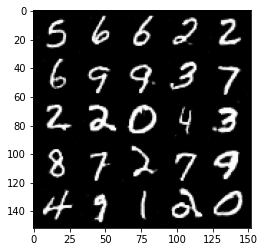

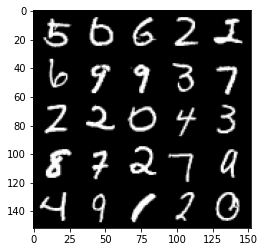

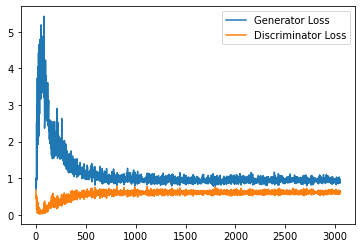

Step 61500: Generator loss: 0.9478360438346862, discriminator loss: 0.6165313841700554


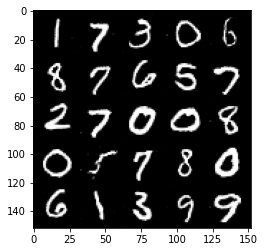

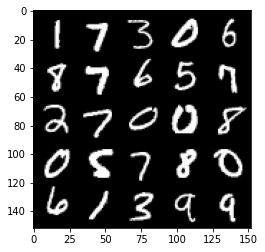

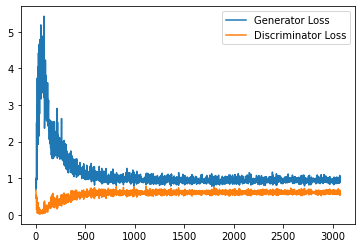

Step 62000: Generator loss: 0.9310309536457062, discriminator loss: 0.6155335463285446


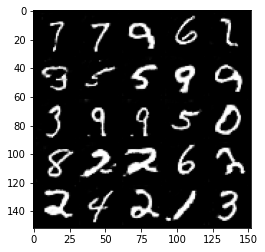

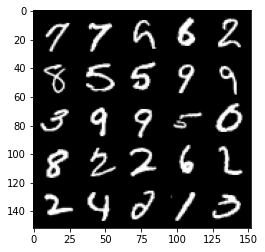

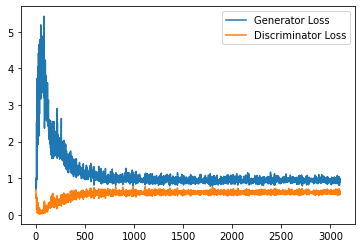

Step 62500: Generator loss: 0.9360756796598434, discriminator loss: 0.6179017924666405


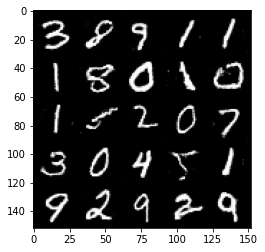

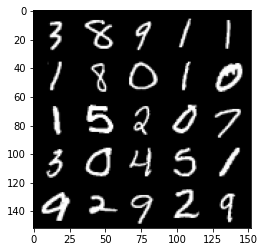

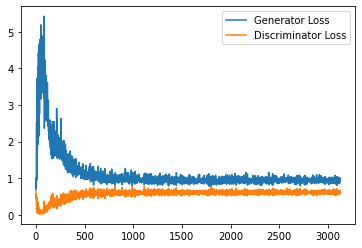

Step 63000: Generator loss: 0.9530994226932525, discriminator loss: 0.6136091973781586


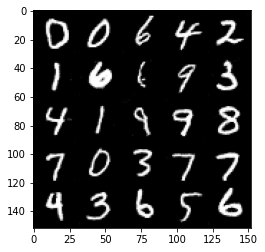

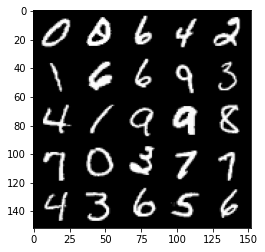

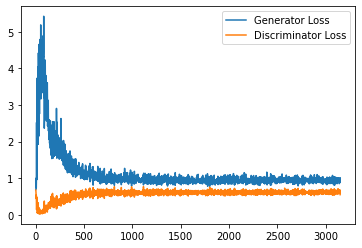

Step 63500: Generator loss: 0.9361277588605881, discriminator loss: 0.6231262499094009


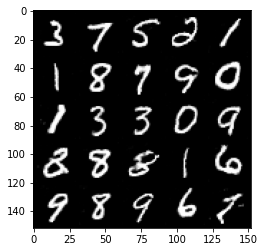

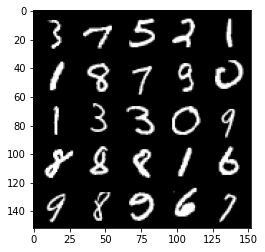

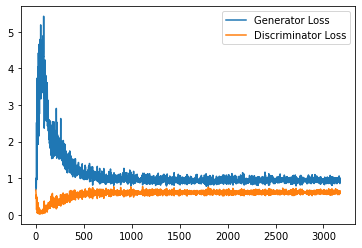

Step 64000: Generator loss: 0.9454566156864166, discriminator loss: 0.617985399723053


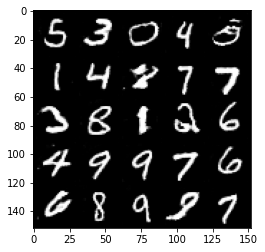

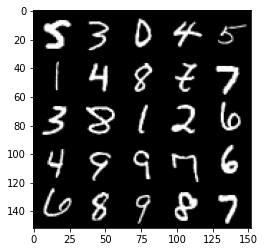

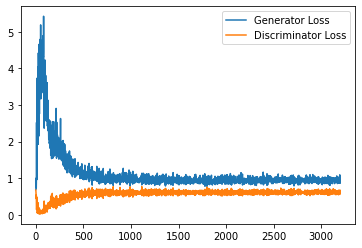

Step 64500: Generator loss: 0.9446989696025848, discriminator loss: 0.6164505767226219


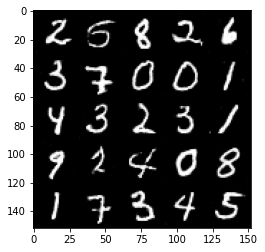

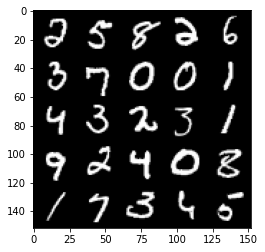

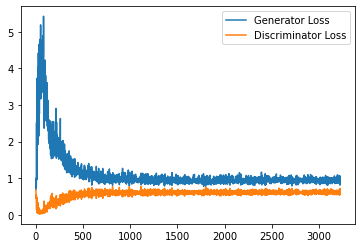

Step 65000: Generator loss: 0.9442555295228958, discriminator loss: 0.6167730193734169


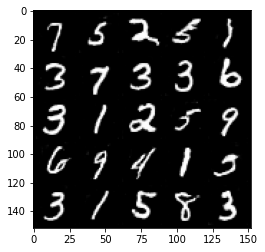

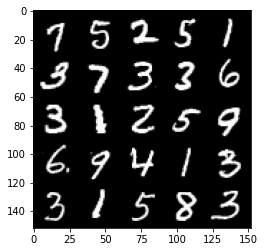

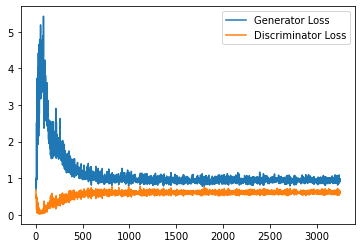

Step 65500: Generator loss: 0.9165732446908951, discriminator loss: 0.6218140189647674


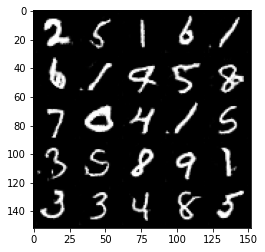

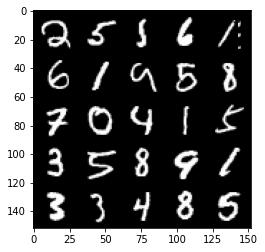

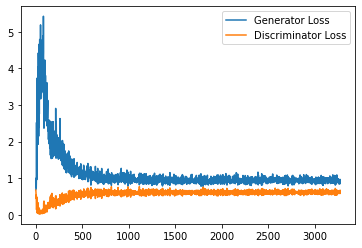

Step 66000: Generator loss: 0.9434850319623947, discriminator loss: 0.6195239199399948


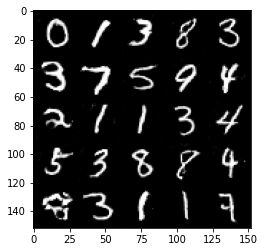

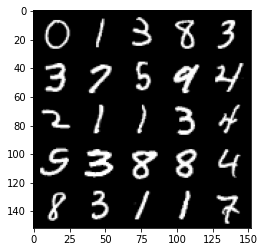

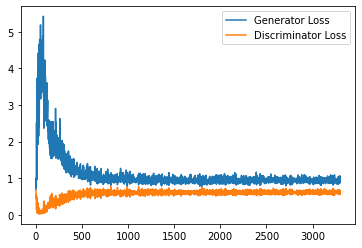

Step 66500: Generator loss: 0.9324645524024964, discriminator loss: 0.6186995567083359


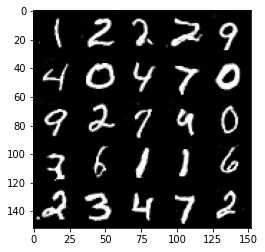

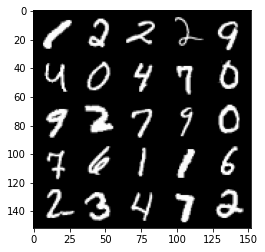

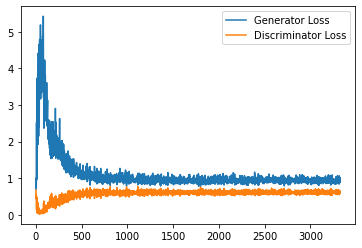

Step 67000: Generator loss: 0.9308525675535202, discriminator loss: 0.6178384321928024


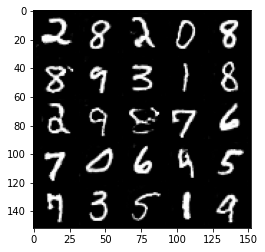

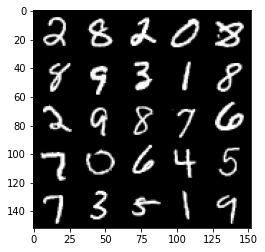

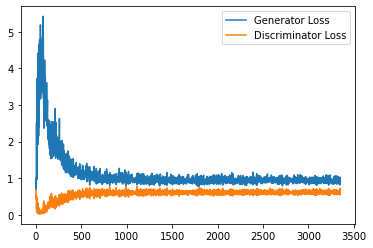

Step 67500: Generator loss: 0.931208407998085, discriminator loss: 0.6252902340292931


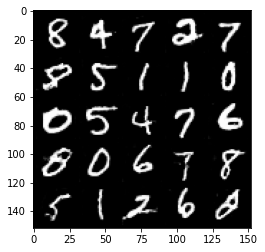

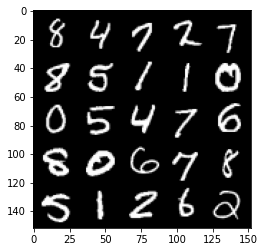

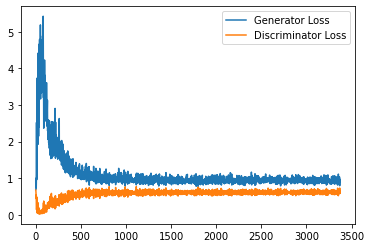

Step 68000: Generator loss: 0.9192649942636489, discriminator loss: 0.6228763785362244


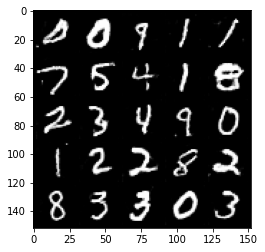

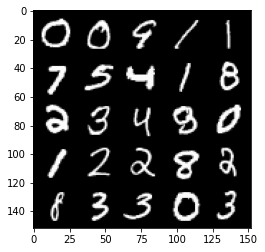

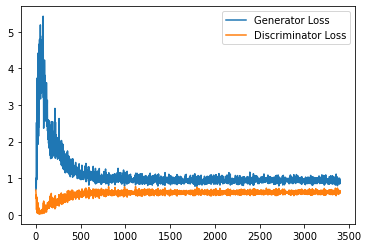

Step 68500: Generator loss: 0.9271919524669647, discriminator loss: 0.6250432955622673


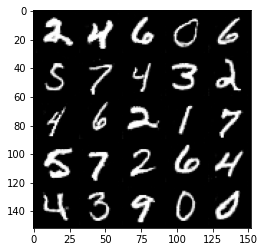

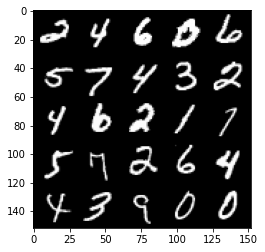

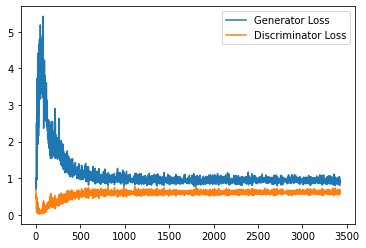

Step 69000: Generator loss: 0.9283493009805679, discriminator loss: 0.6228901600837707


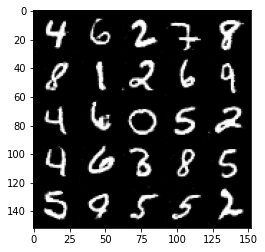

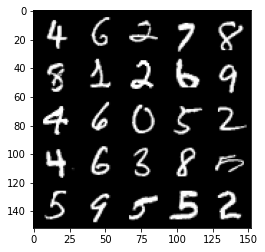

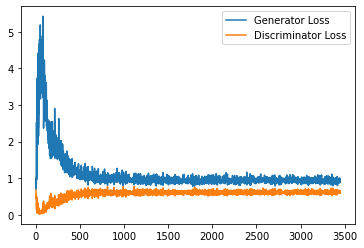

Step 69500: Generator loss: 0.9370867751836777, discriminator loss: 0.6192520117163658


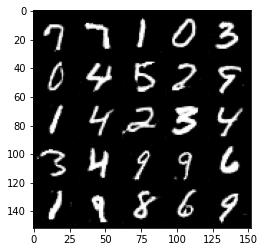

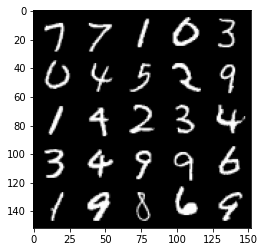

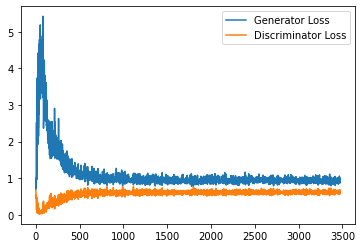

Step 70000: Generator loss: 0.9309345800876617, discriminator loss: 0.618036233305931


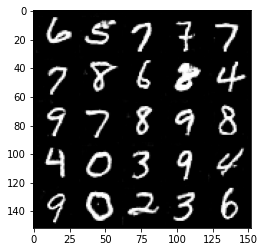

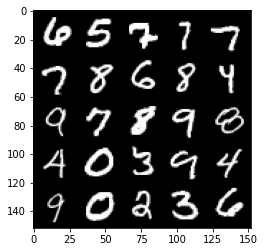

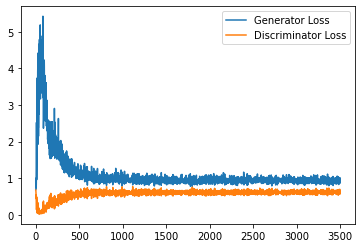

Step 70500: Generator loss: 0.917667931675911, discriminator loss: 0.6205415209531784


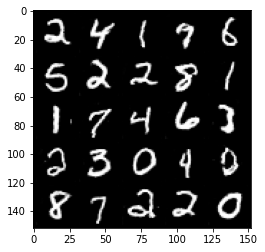

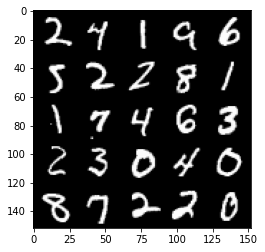

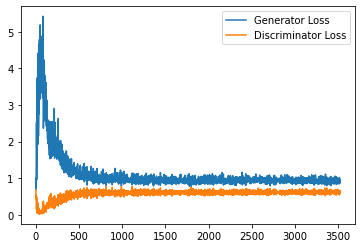

Step 71000: Generator loss: 0.9398208698034286, discriminator loss: 0.6215773442387581


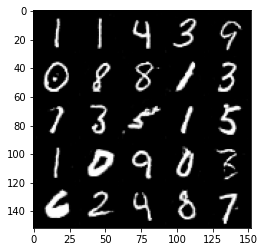

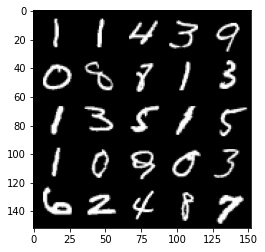

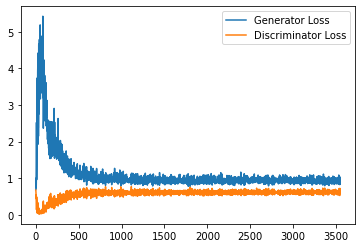

Step 71500: Generator loss: 0.9164731651544571, discriminator loss: 0.6299496018886566


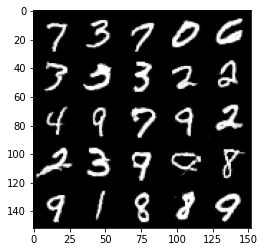

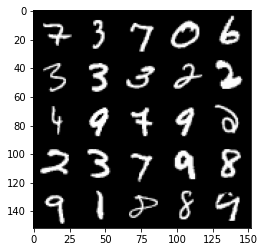

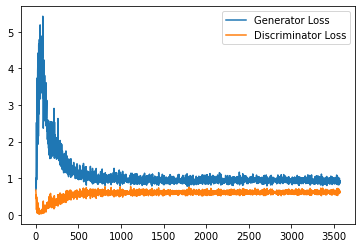

Step 72000: Generator loss: 0.9182999094724655, discriminator loss: 0.622250281214714


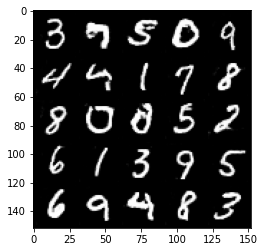

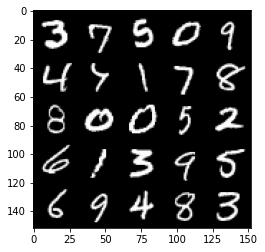

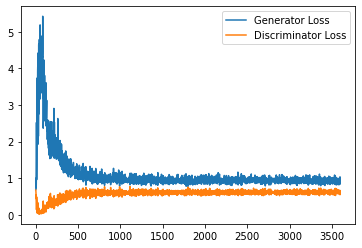

Step 72500: Generator loss: 0.9286803697347641, discriminator loss: 0.620720702290535


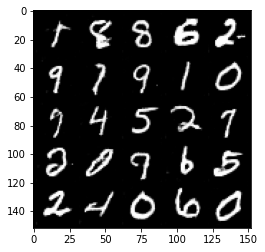

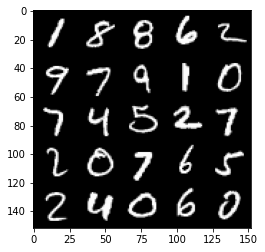

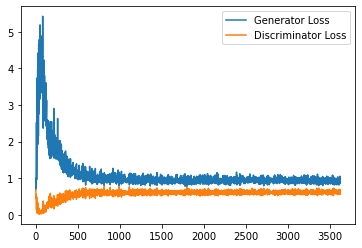

Step 73000: Generator loss: 0.9219721020460129, discriminator loss: 0.6291337248682976


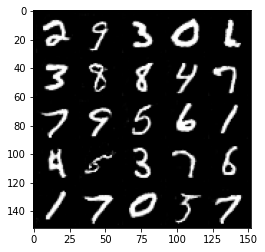

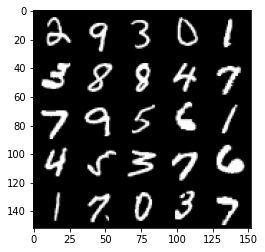

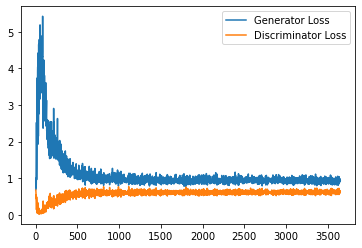

Step 73500: Generator loss: 0.911755183339119, discriminator loss: 0.6248148546218872


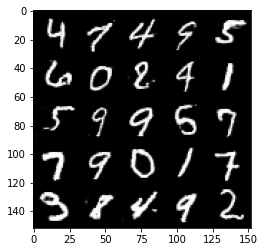

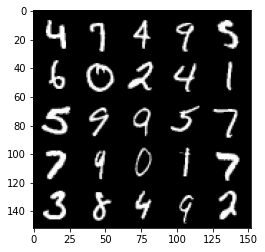

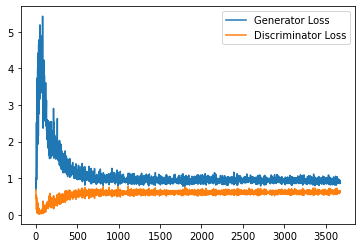

Step 74000: Generator loss: 0.9310862240791321, discriminator loss: 0.6240599755644798


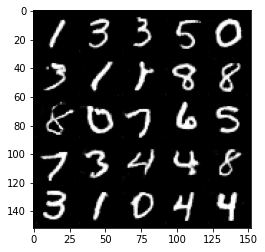

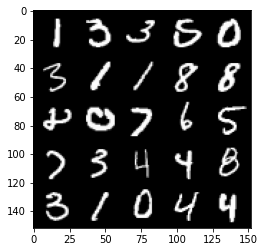

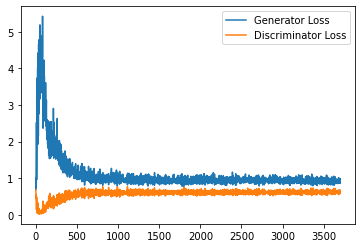

Step 74500: Generator loss: 0.9371919286251068, discriminator loss: 0.6207547523975372


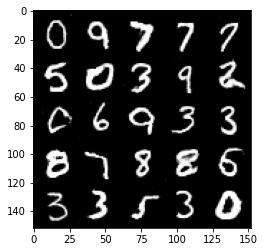

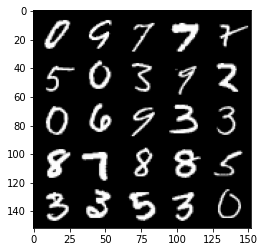

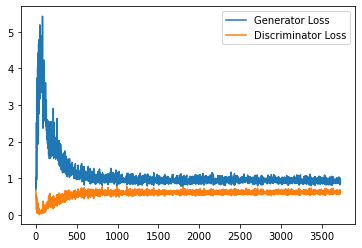

Step 75000: Generator loss: 0.9357413954734802, discriminator loss: 0.624123874425888


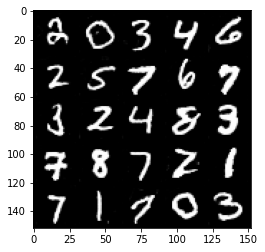

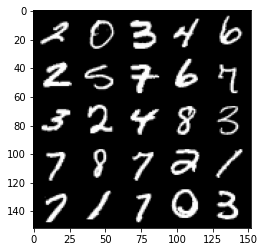

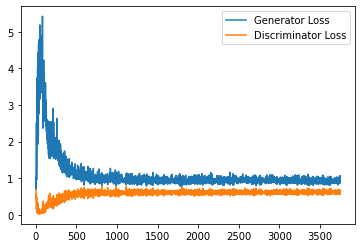

Step 75500: Generator loss: 0.9106559332609176, discriminator loss: 0.6229405506849289


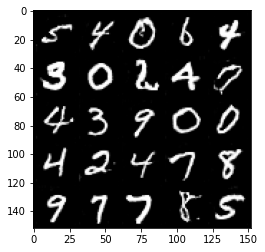

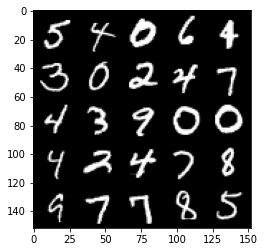

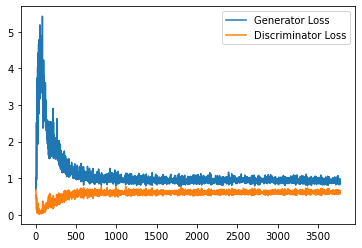

Step 76000: Generator loss: 0.9219819972515106, discriminator loss: 0.6264739779829979


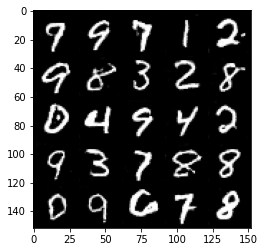

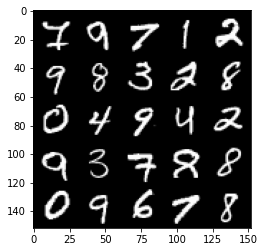

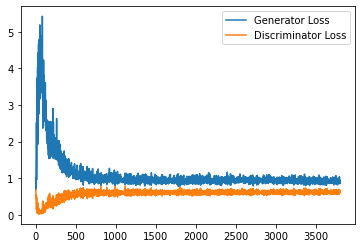

Step 76500: Generator loss: 0.9186893829107284, discriminator loss: 0.6270554724931717


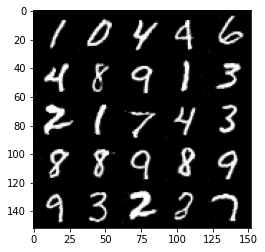

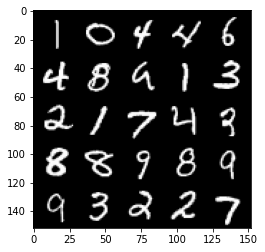

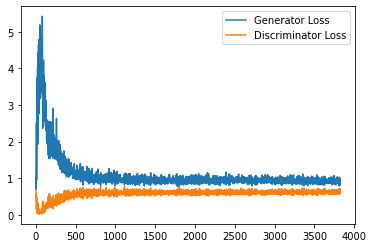

Step 77000: Generator loss: 0.9223389000892639, discriminator loss: 0.62468619120121


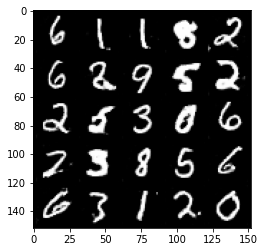

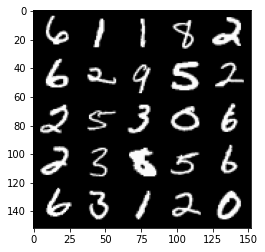

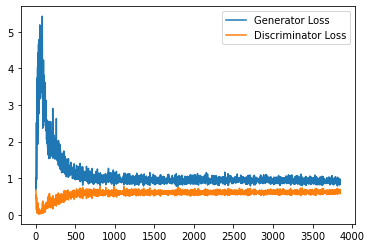

Step 77500: Generator loss: 0.9175396126508713, discriminator loss: 0.6250372586250306


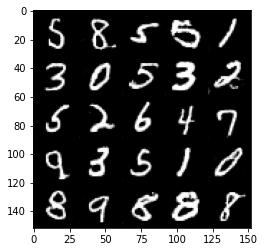

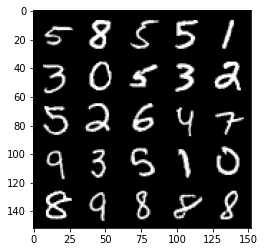

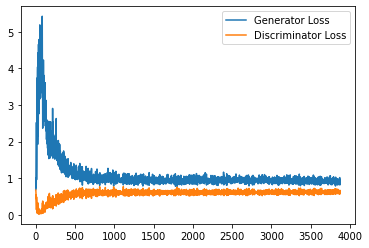

Step 78000: Generator loss: 0.9166972033977508, discriminator loss: 0.6218589336872101


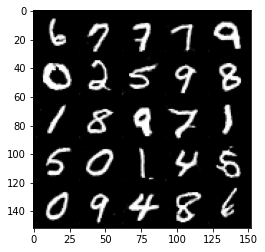

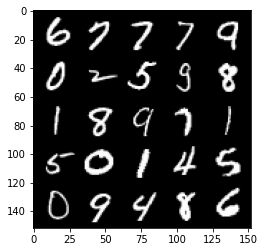

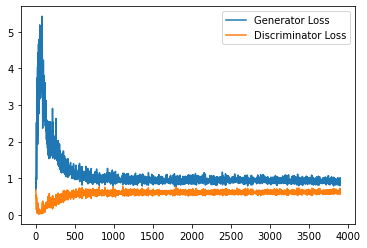

Step 78500: Generator loss: 0.9141155569553375, discriminator loss: 0.6275406571626663


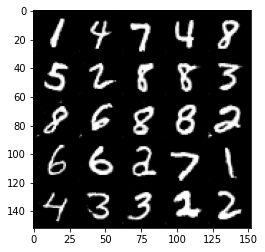

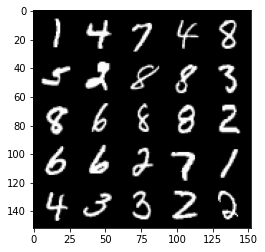

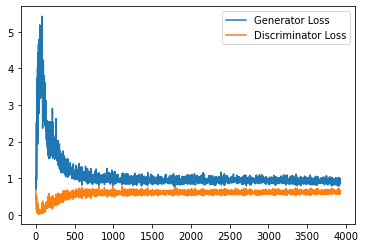

Step 79000: Generator loss: 0.9064080027341843, discriminator loss: 0.6259945542812347


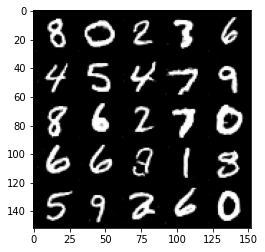

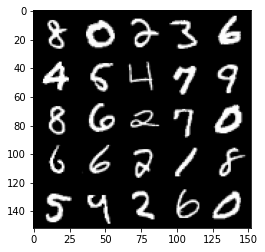

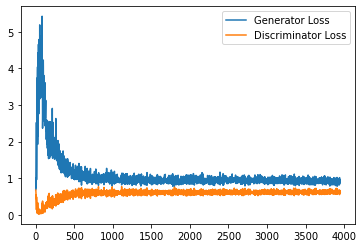

Step 79500: Generator loss: 0.9108299514055253, discriminator loss: 0.6242296061515809


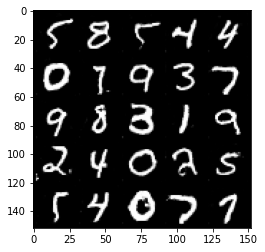

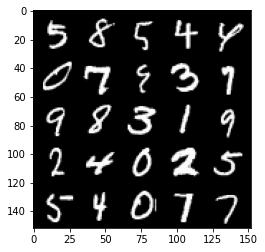

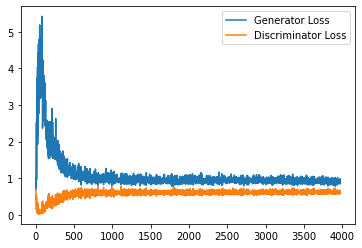

Step 80000: Generator loss: 0.9172229478359223, discriminator loss: 0.6279373664855957


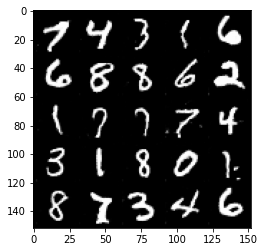

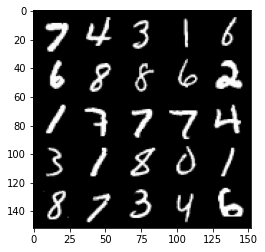

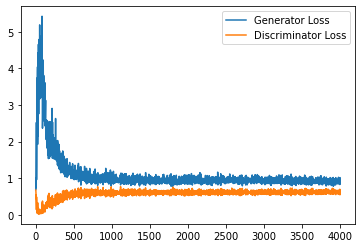

Step 80500: Generator loss: 0.9122169982194901, discriminator loss: 0.6280984119176864


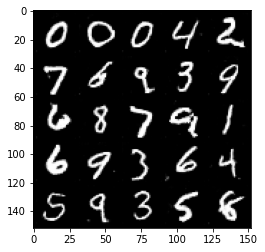

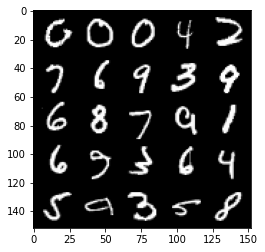

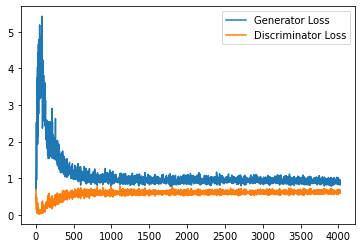

Step 81000: Generator loss: 0.9087831201553345, discriminator loss: 0.6248560482859612


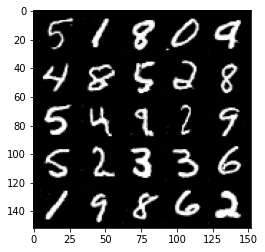

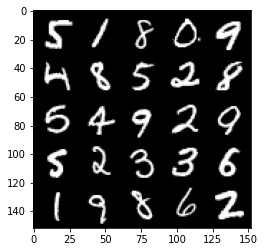

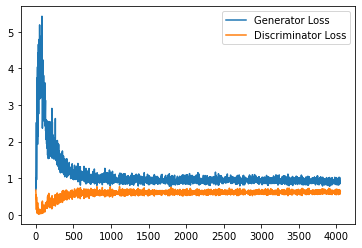

Step 81500: Generator loss: 0.9283021661043167, discriminator loss: 0.6245296331644058


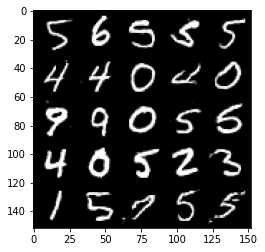

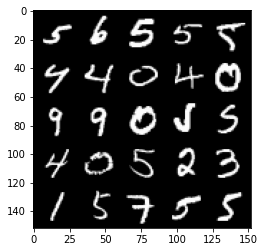

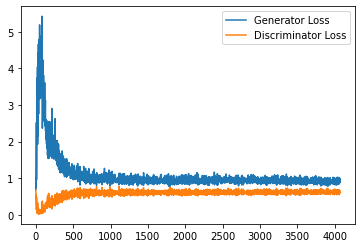

Step 82000: Generator loss: 0.9064297074079514, discriminator loss: 0.6297457038164139


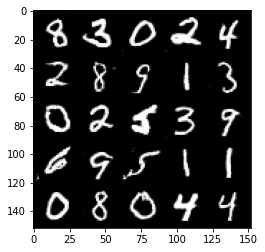

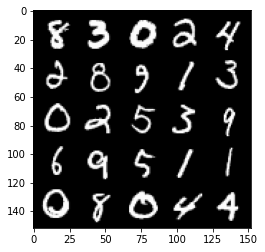

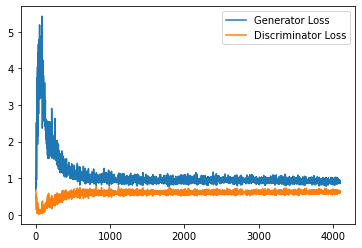

Step 82500: Generator loss: 0.9060706952810288, discriminator loss: 0.6289071446657181


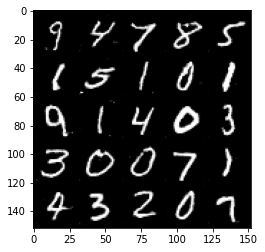

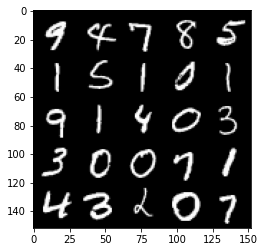

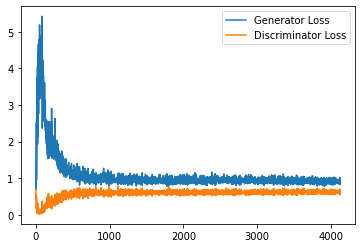

Step 83000: Generator loss: 0.9104745779037475, discriminator loss: 0.6287235733270645


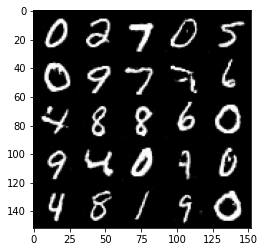

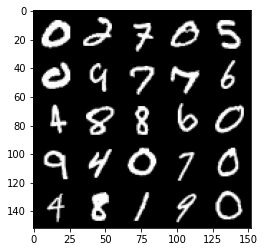

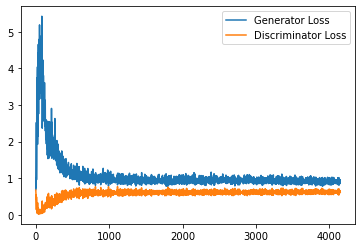

Step 83500: Generator loss: 0.9163877750635148, discriminator loss: 0.6242944969534874


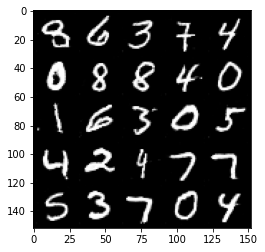

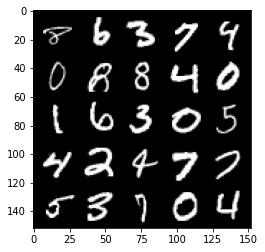

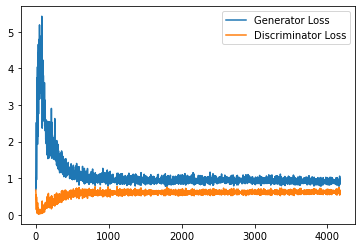

Step 84000: Generator loss: 0.8941767674684524, discriminator loss: 0.6320117415189743


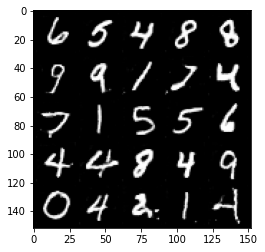

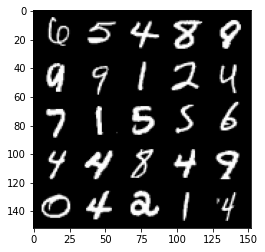

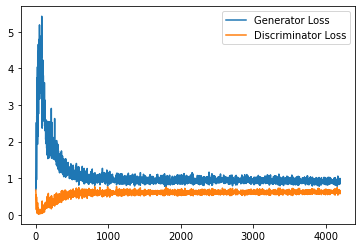

Step 84500: Generator loss: 0.9091614735126495, discriminator loss: 0.6290146019458771


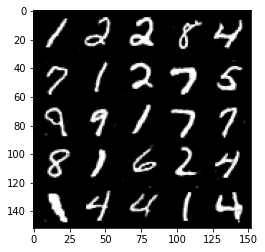

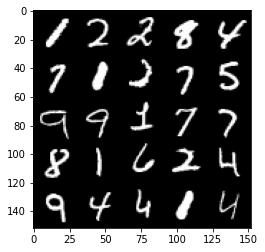

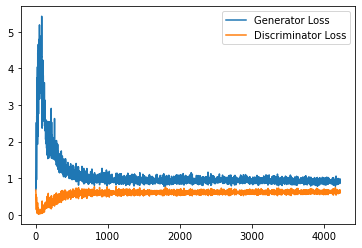

Step 85000: Generator loss: 0.9064081838130951, discriminator loss: 0.629611202955246


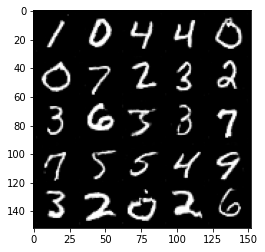

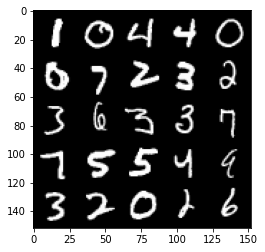

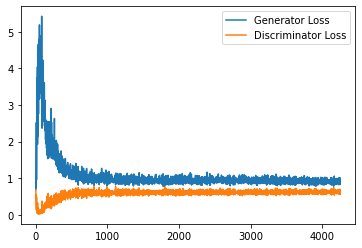

Step 85500: Generator loss: 0.9064964896440506, discriminator loss: 0.6282955800890923


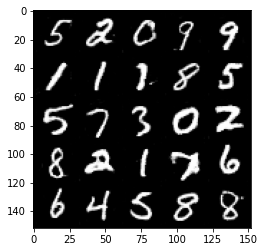

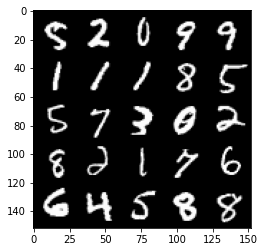

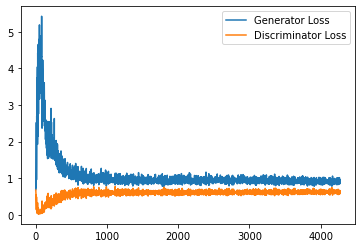

Step 86000: Generator loss: 0.9118739454746246, discriminator loss: 0.6329341150522232


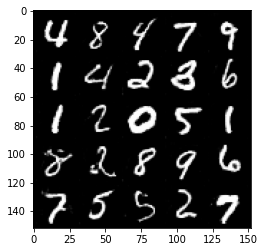

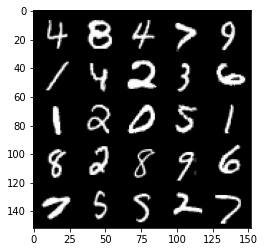

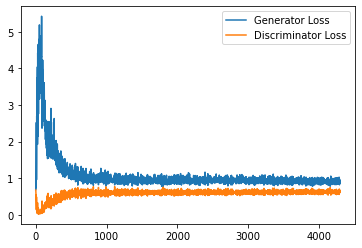

Step 86500: Generator loss: 0.9107984697818756, discriminator loss: 0.625026515841484


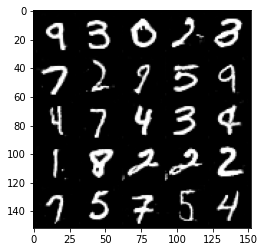

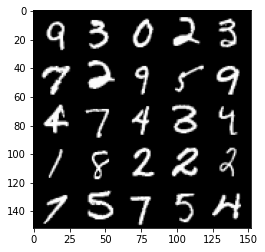

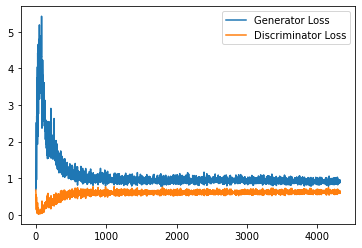

Step 87000: Generator loss: 0.9077560528516769, discriminator loss: 0.6281485598683357


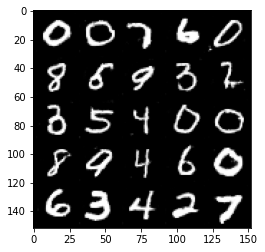

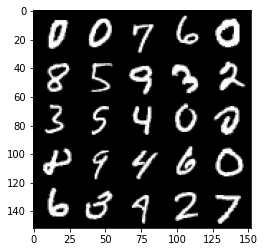

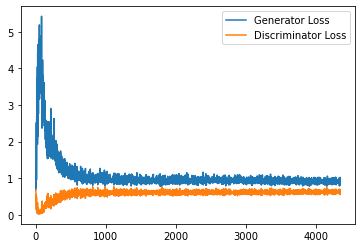

Step 87500: Generator loss: 0.8998931167125702, discriminator loss: 0.6301609570980072


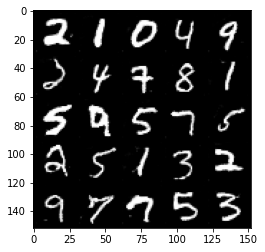

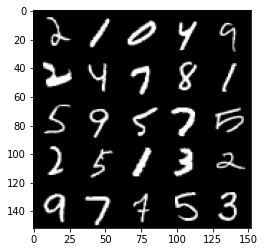

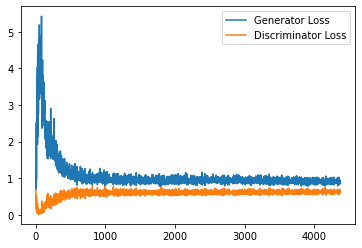

Step 88000: Generator loss: 0.9173999944925308, discriminator loss: 0.6298538345098496


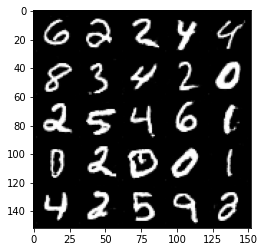

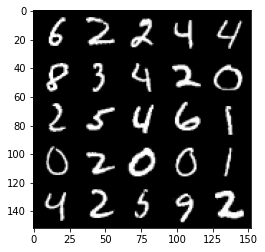

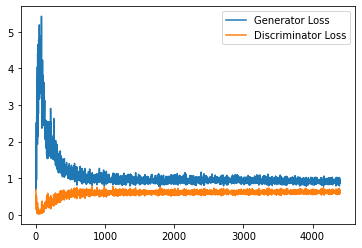

Step 88500: Generator loss: 0.9035966591835022, discriminator loss: 0.6301297864913941


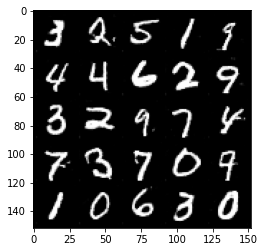

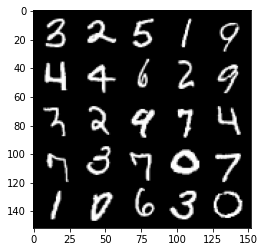

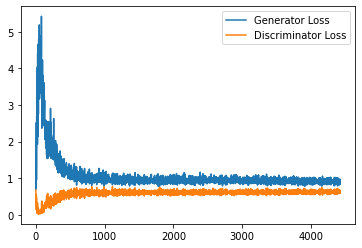

Step 89000: Generator loss: 0.8998917807340622, discriminator loss: 0.6299180173873902


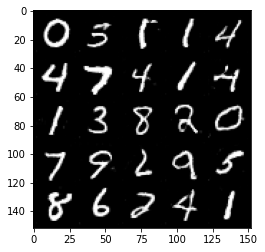

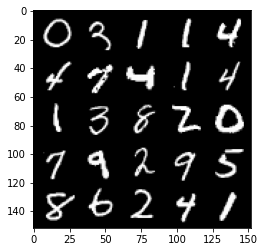

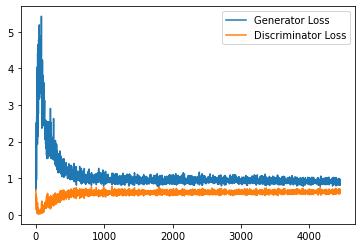

Step 89500: Generator loss: 0.8947454192638398, discriminator loss: 0.6323002731800079


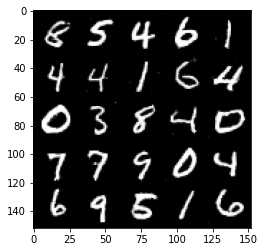

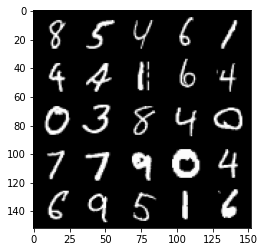

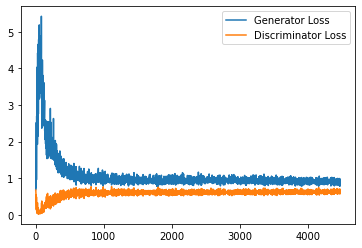

Step 90000: Generator loss: 0.9045669145584107, discriminator loss: 0.6301084104180336


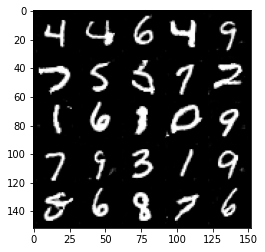

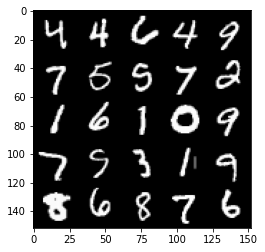

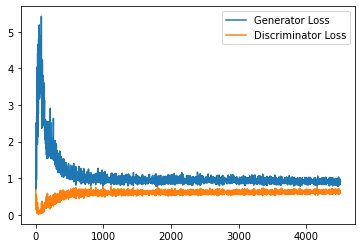

Step 90500: Generator loss: 0.9064888974428177, discriminator loss: 0.6285767186880111


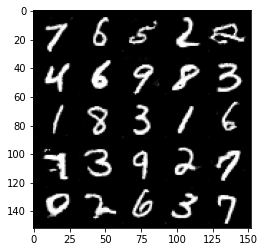

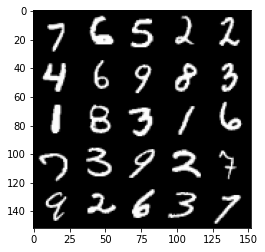

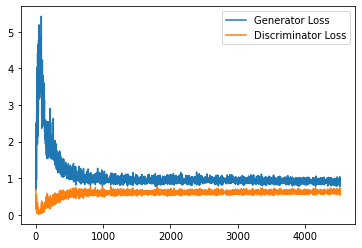

Step 91000: Generator loss: 0.9026554175615311, discriminator loss: 0.6322959649562836


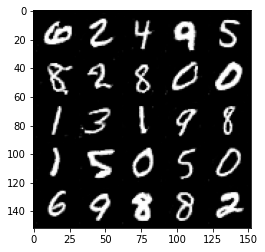

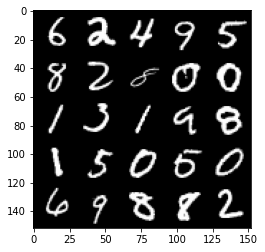

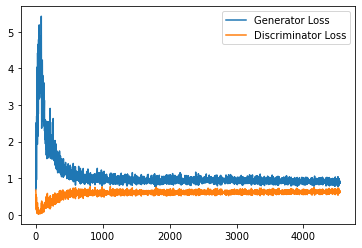

Step 91500: Generator loss: 0.9101466348171234, discriminator loss: 0.6277487351894379


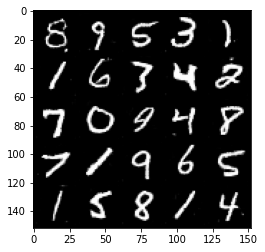

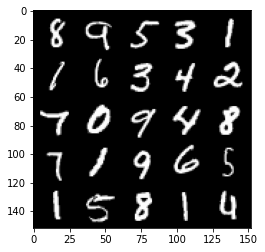

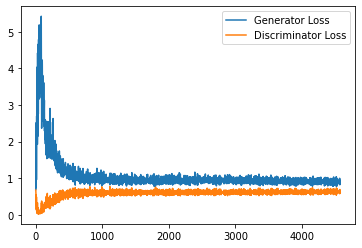

Step 92000: Generator loss: 0.9040560398101807, discriminator loss: 0.6300283399820328


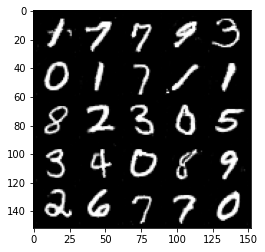

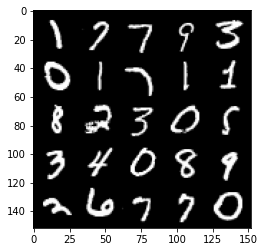

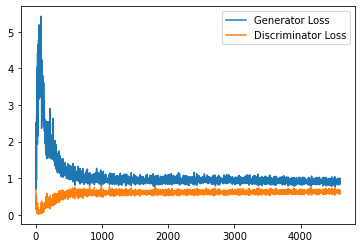

Step 92500: Generator loss: 0.9094929397106171, discriminator loss: 0.6324061513543129


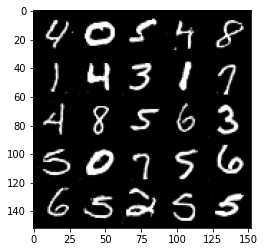

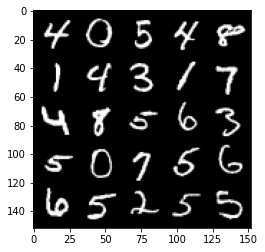

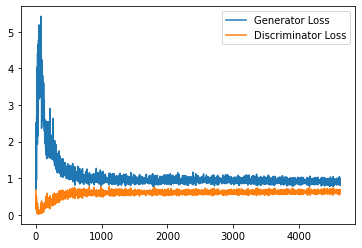

Step 93000: Generator loss: 0.8973709887266159, discriminator loss: 0.6275284069776536


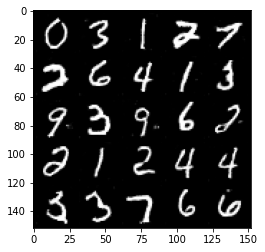

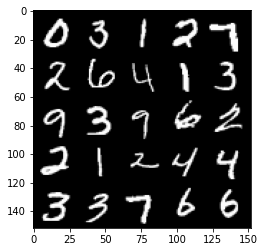

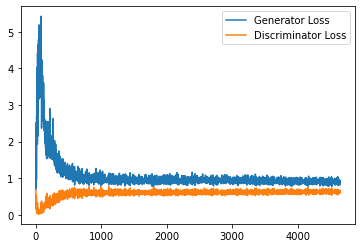

Step 93500: Generator loss: 0.9075497947931289, discriminator loss: 0.6323444105386734


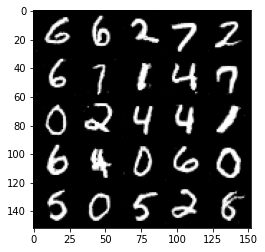

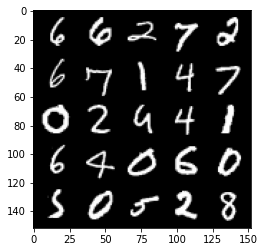

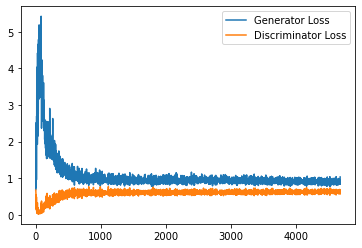

In [14]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [15]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

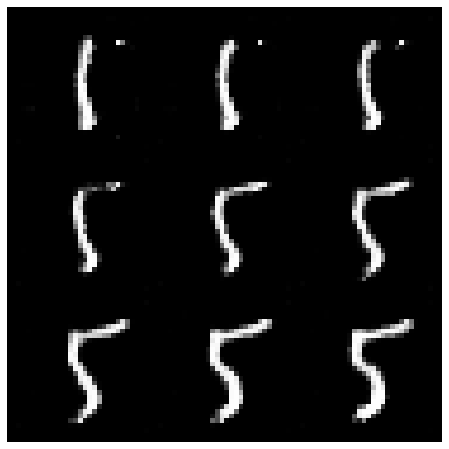

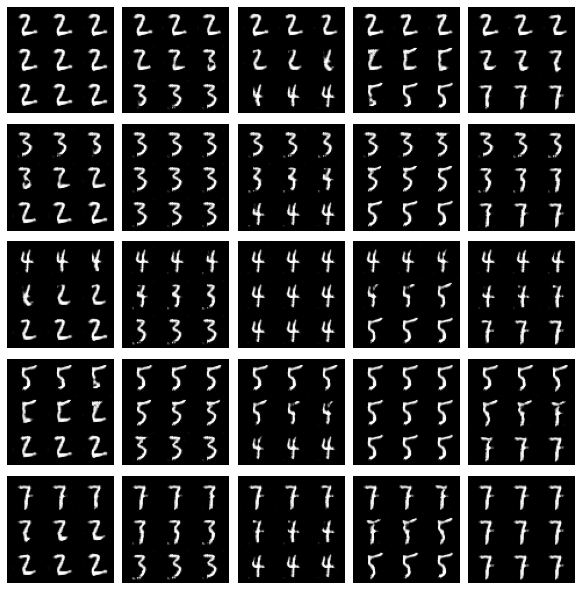

In [16]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
plot_numbers = [2, 3, 4, 5, 7]
n_numbers = len(plot_numbers)
plt.figure(figsize=(8, 8))
for i, first_plot_number in enumerate(plot_numbers):
     for j, second_plot_number in enumerate(plot_numbers):
            plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
            interpolate_class(first_plot_number, second_plot_number)
            plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

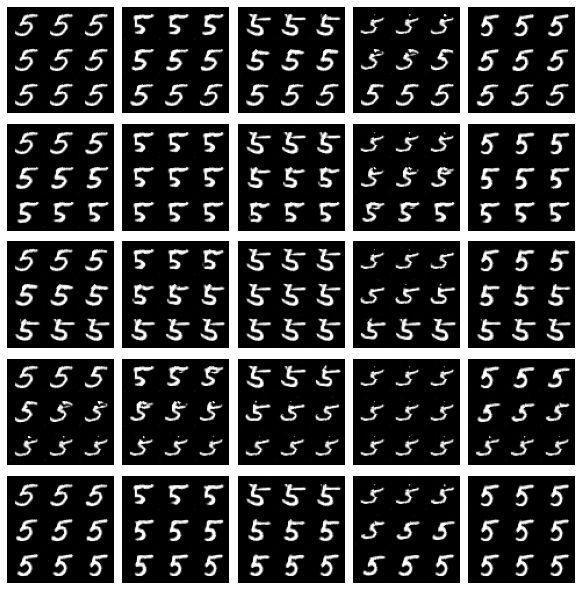

In [17]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()